# Wasserstein GAN with Gradient Penalty (WGAN-GP)

### Goals
In this notebook, you're going to build a Wasserstein GAN with Gradient Penalty (WGAN-GP) that solves some of the stability issues with the GANs that you have been using up until this point. Specifically, you'll use a special kind of loss function known as the W-loss, where W stands for Wasserstein, and gradient penalties to prevent mode collapse.

*Fun Fact: Wasserstein is named after a mathematician at Penn State, Leonid Vaseršteĭn. You'll see it abbreviated to W (e.g. WGAN, W-loss, W-distance).*

### Learning Objectives
1.   Get hands-on experience building a more stable GAN: Wasserstein GAN with Gradient Penalty (WGAN-GP).
2.   Train the more advanced WGAN-GP model.



## Generator and Critic

You will begin by importing some useful packages, defining visualization functions, building the generator, and building the critic. Since the changes for WGAN-GP are done to the loss function during training, you can simply reuse your previous GAN code for the generator and critic class. Remember that in WGAN-GP, you no longer use a discriminator that classifies fake and real as 0 and 1 but rather a critic that scores images with real numbers.

#### Packages and Visualizations

In [83]:
import torch
import numpy as np
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28)):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()

def make_grad_hook():
    '''
    Function to keep track of gradients for visualization purposes, 
    which fills the grads list when using model.apply(grad_hook).
    '''
    grads = []
    def grad_hook(m):
        if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
            grads.append(m.weight.grad)
    return grads, grad_hook

#### Generator and Noise

In [84]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        z_dim: the dimension of the noise vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, z_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.z_dim = z_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(z_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor,
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, z_dim)
        '''
        x = noise.view(len(noise), self.z_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, z_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, z_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
      n_samples: the number of samples to generate, a scalar
      z_dim: the dimension of the noise vector, a scalar
      device: the device type
    '''
    return torch.randn(n_samples, z_dim, device=device)

#### Critic

In [85]:
class Critic(nn.Module):
    '''
    Critic Class
    Values:
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Critic, self).__init__()
        self.crit = nn.Sequential(
            self.make_crit_block(im_chan, hidden_dim),
            self.make_crit_block(hidden_dim, hidden_dim * 2),
            self.make_crit_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_crit_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a critic block of DCGAN;
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the critic: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        crit_pred = self.crit(image)
        return crit_pred.view(len(crit_pred), -1)

## Training Initializations
Now you can start putting it all together.
As usual, you will start by setting the parameters:
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   beta_1, beta_2: the momentum terms
  *   c_lambda: weight of the gradient penalty
  *   crit_repeats: number of times to update the critic per generator update - there are more details about this in the *Putting It All Together* section
  *   device: the device type

You will also load and transform the MNIST dataset to tensors.




In [86]:
n_epochs = 100
z_dim = 64
display_step = 50
batch_size = 128
lr = 0.0002
beta_1 = 0.5
beta_2 = 0.999
c_lambda = 10
crit_repeats = 5
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, critic, and optimizers.

In [101]:
gen = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr, betas=(beta_1, beta_2))
crit = Critic().to(device) 
crit_opt = torch.optim.Adam(crit.parameters(), lr=lr, betas=(beta_1, beta_2))

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
crit = crit.apply(weights_init)


## Gradient Penalty
Calculating the gradient penalty can be broken into two functions: (1) compute the gradient with respect to the images and (2) compute the gradient penalty given the gradient.

You can start by getting the gradient. The gradient is computed by first creating a mixed image. This is done by weighing the fake and real image using epsilon and then adding them together. Once you have the intermediate image, you can get the critic's output on the image. Finally, you compute the gradient of the critic score's on the mixed images (output) with respect to the pixels of the mixed images (input). You will need to fill in the code to get the gradient wherever you see *None*. There is a test function in the next block for you to test your solution.

In [102]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_gradient
def get_gradient(crit, real, fake, epsilon):
    '''
    Return the gradient of the critic's scores with respect to mixes of real and fake images.
    Parameters:
        crit: the critic model
        real: a batch of real images
        fake: a batch of fake images
        epsilon: a vector of the uniformly random proportions of real/fake per mixed image
    Returns:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    '''
    # Mix the images together
    mixed_images = real * epsilon + fake * (1 - epsilon)

    # Calculate the critic's scores on the mixed images
    mixed_scores = crit(mixed_images)
    
    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        # Note: You need to take the gradient of outputs with respect to inputs.
        # This documentation may be useful, but it should not be necessary:
        # https://pytorch.org/docs/stable/autograd.html#torch.autograd.grad
        #### START CODE HERE ####
        inputs=mixed_images,
        outputs=mixed_scores,
        #### END CODE HERE ####
        # These other parameters have to do with the pytorch autograd engine works
        grad_outputs=torch.ones_like(mixed_scores), 
        create_graph=True,
        retain_graph=True,
    )[0]
    return gradient


In [103]:
# UNIT TEST
# DO NOT MODIFY THIS
def test_get_gradient(image_shape):
    real = torch.randn(*image_shape, device=device) + 1
    fake = torch.randn(*image_shape, device=device) - 1
    epsilon_shape = [1 for _ in image_shape]
    epsilon_shape[0] = image_shape[0]
    epsilon = torch.rand(epsilon_shape, device=device).requires_grad_()
    gradient = get_gradient(crit, real, fake, epsilon)
    assert tuple(gradient.shape) == image_shape
    assert gradient.max() > 0
    assert gradient.min() < 0
    return gradient

gradient = test_get_gradient((256, 1, 28, 28))
print("Success!")

Success!


The second function you need to complete is to compute the gradient penalty given the gradient. First, you calculate the magnitude of each image's gradient. The magnitude of a gradient is also called the norm. Then, you calculate the penalty by squaring the distance between each magnitude and the ideal norm of 1 and taking the mean of all the squared distances.

Again, you will need to fill in the code wherever you see *None*. There are hints below that you can view if you need help and there is a test function in the next block for you to test your solution.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">gradient_penalty</font></code></b>
</font>
</summary>


1.   Make sure you take the mean at the end.
2.   Note that the magnitude of each gradient has already been calculated for you.

</details>


In [104]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: gradient_penalty
def gradient_penalty(gradient):
    '''
    Return the gradient penalty, given a gradient.
    Given a batch of image gradients, you calculate the magnitude of each image's gradient
    and penalize the mean quadratic distance of each magnitude to 1.
    Parameters:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    Returns:
        penalty: the gradient penalty
    '''
    # Flatten the gradients so that each row captures one image
    gradient = gradient.view(len(gradient), -1)

    # Calculate the magnitude of every row
    gradient_norm = gradient.norm(2, dim=1)
    
    # Penalize the mean squared distance of the gradient norms from 1
    #### START CODE HERE ####
    #loss=nn.MSELoss()
    penalty = ((gradient_norm-1)**2).mean()
    #### END CODE HERE ####
    return penalty

In [105]:
#gradient_penalty((256, 1, 28, 28))

In [106]:
image_shape=(256, 1, 28, 28)
gradient = torch.zeros(*image_shape)
gradient.shape

torch.Size([256, 1, 28, 28])

In [93]:
gradient = gradient.view(len(gradient), -1)
gradient.shape

torch.Size([256, 784])

In [94]:
gradient_norm = gradient.norm(2, dim=1)
#gradient_norm

In [95]:
#((torch.tensor(1.)-gradient_norm)**2)

In [96]:
bad_gradient_penalty=((torch.tensor(1.)-gradient_norm)**2).mean()
torch.isclose(bad_gradient_penalty, torch.tensor(1.))

tensor(True)

In [97]:
image_size = torch.prod(torch.Tensor(image_shape[1:]))
print(image_size)
good_gradient = torch.ones(*image_shape) / torch.sqrt(image_size)
#(good_gradient)[0]

tensor(784.)


In [98]:
good_gradient_penalty=((torch.tensor(1.)-good_gradient)**2)
#good_gradient_penalty

In [99]:
image_size = torch.prod(torch.Tensor(image_shape[1:]))
print(image_size)
good_gradient = torch.ones(*image_shape) / torch.sqrt(image_size)
#print(good_gradient)
good_gradient_penalty = gradient_penalty(good_gradient)
print(good_gradient_penalty)
#torch.isclose(good_gradient_penalty, torch.tensor(0.))

tensor(784.)
tensor(3.1392e-11)


In [107]:
# UNIT TEST
def test_gradient_penalty(image_shape):
    bad_gradient = torch.zeros(*image_shape)
    bad_gradient_penalty = gradient_penalty(bad_gradient)
    assert torch.isclose(bad_gradient_penalty, torch.tensor(1.))

    image_size = torch.prod(torch.Tensor(image_shape[1:]))
    good_gradient = torch.ones(*image_shape) / torch.sqrt(image_size)
    good_gradient_penalty = gradient_penalty(good_gradient)
    assert torch.isclose(good_gradient_penalty, torch.tensor(0.))

    random_gradient = test_get_gradient(image_shape)
    random_gradient_penalty = gradient_penalty(random_gradient)
    assert torch.abs(random_gradient_penalty - 1) < 0.1

test_gradient_penalty((256, 1, 28, 28))
print("Success!")

Success!


## Losses
Next, you need to calculate the loss for the generator and the critic.

For the generator, the loss is calculated by maximizing the critic's prediction on the generator's fake images. The argument has the scores for all fake images in the batch, but you will use the mean of them.

There are optional hints below and a test function in the next block for you to test your solution.

<details><summary><font size="3" color="green"><b>Optional hints for <code><font size="4">get_gen_loss</font></code></b></font></summary>

1. This can be written in one line.
2. This is the negative of the mean of the critic's scores.

</details>

In [109]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_gen_loss
def get_gen_loss(crit_fake_pred):
    '''
    Return the loss of a generator given the critic's scores of the generator's fake images.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
    Returns:
        gen_loss: a scalar loss value for the current batch of the generator
    '''
    #### START CODE HERE ####
    gen_loss = -torch.mean(crit_fake_pred)
    #gen_loss=gen(crit_fake_pred)
    #### END CODE HERE ####
    return gen_loss

In [112]:
# UNIT TEST
assert torch.isclose(
    get_gen_loss(torch.tensor(1.)), torch.tensor(-1.0)
)

assert torch.isclose(
    get_gen_loss(torch.rand(10000)), torch.tensor(-0.5), 0.05
)

print("Success!")

Success!


For the critic, the loss is calculated by maximizing the distance between the critic's predictions on the real images and the predictions on the fake images while also adding a gradient penalty. The gradient penalty is weighed according to lambda. The arguments are the scores for all the images in the batch, and you will use the mean of them.

There are hints below if you get stuck and a test function in the next block for you to test your solution.

<details><summary><font size="3" color="green"><b>Optional hints for <code><font size="4">get_crit_loss</font></code></b></font></summary>

1. The higher the mean fake score, the higher the critic's loss is.
2. What does this suggest about the mean real score?
3. The higher the gradient penalty, the higher the critic's loss is, proportional to lambda.


</details>


In [80]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_crit_loss
def get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda):
    '''
    Return the loss of a critic given the critic's scores for fake and real images,
    the gradient penalty, and gradient penalty weight.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
        crit_real_pred: the critic's scores of the real images
        gp: the unweighted gradient penalty
        c_lambda: the current weight of the gradient penalty 
    Returns:
        crit_loss: a scalar for the critic's loss, accounting for the relevant factors
    '''
    #### START CODE HERE ####
    crit_loss =  -torch.mean(crit_real_pred) + torch.mean(crit_fake_pred) + c_lambda * gp
    #### END CODE HERE ####
    return crit_loss

In [81]:
# UNIT TEST
assert torch.isclose(
    get_crit_loss(torch.tensor(1.), torch.tensor(2.), torch.tensor(3.), 0.1),
    torch.tensor(-0.7)
)
assert torch.isclose(
    get_crit_loss(torch.tensor(20.), torch.tensor(-20.), torch.tensor(2.), 10),
    torch.tensor(60.)
)

print("Success!")

Success!


## Putting It All Together
Before you put everything together, there are a few things to note.
1.   Even on GPU, the **training will run more slowly** than previous labs because the gradient penalty requires you to compute the gradient of a gradient -- this means potentially a few minutes per epoch! For best results, run this for as long as you can while on GPU.
2.   One important difference from earlier versions is that you will **update the critic multiple times** every time you update the generator This helps prevent the generator from overpowering the critic. Sometimes, you might see the reverse, with the generator updated more times than the critic. This depends on architectural (e.g. the depth and width of the network) and algorithmic choices (e.g. which loss you're using). 
3.   WGAN-GP isn't necessarily meant to improve overall performance of a GAN, but just **increases stability** and avoids mode collapse. In general, a WGAN will be able to train in a much more stable way than the vanilla DCGAN from last assignment, though it will generally run a bit slower. You should also be able to train your model for more epochs without it collapsing.


<!-- Once again, be warned that this runs very slowly on a CPU. One way to run this more quickly is to download the .ipynb and upload it to Google Drive, then open it with Google Colab and make the runtime type GPU and replace
`device = "cpu"`
with
`device = "cuda"`
and make sure that your `get_noise` function uses the right device.  -->

Here is a snapshot of what your WGAN-GP outputs should resemble:
![MNIST Digits Progression](MNIST_WGAN_Progression.png)

Step 50: Generator loss: -0.12186830494552851, critic loss: 1.8410947860777371


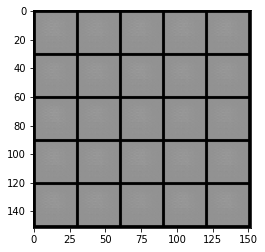

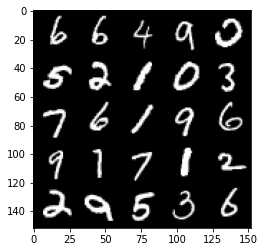

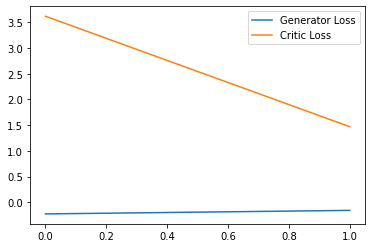

Step 100: Generator loss: 1.6316123974323273, critic loss: -2.9954938621520997


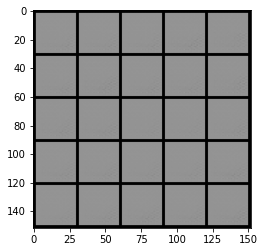

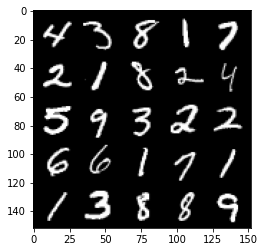

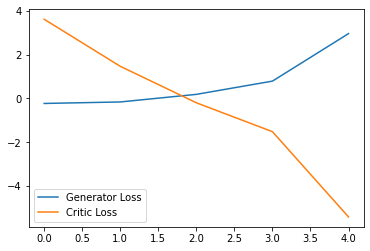

Step 150: Generator loss: 3.7986844539642335, critic loss: -14.114001832962039


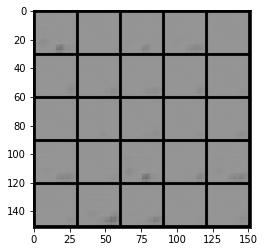

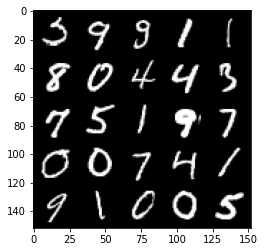

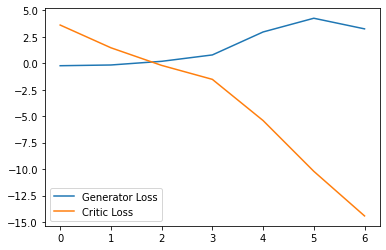

Step 200: Generator loss: 3.3495365238189696, critic loss: -35.5509391784668


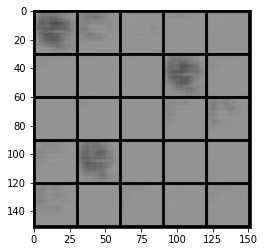

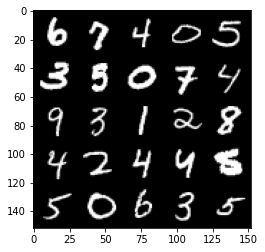

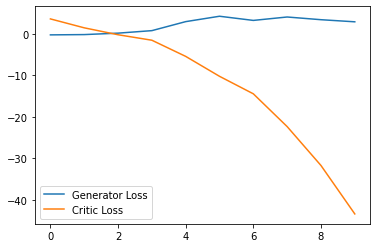

Step 250: Generator loss: 3.7894814586639405, critic loss: -74.01227522277831


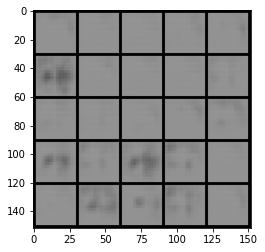

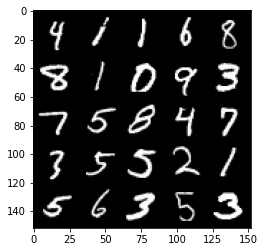

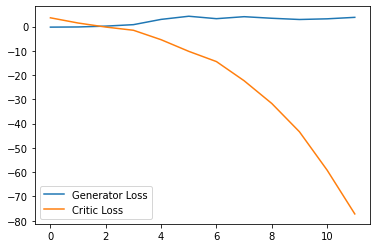

Step 300: Generator loss: 6.765715589523316, critic loss: -122.18015521240235


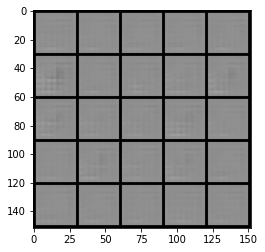

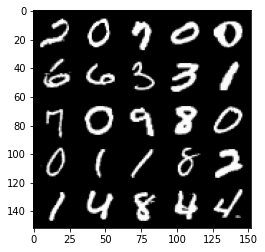

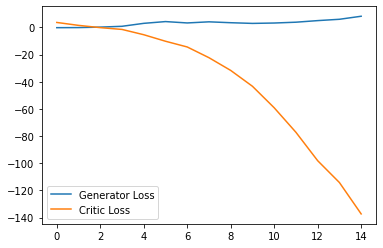

Step 350: Generator loss: 6.76127947807312, critic loss: -167.50385397338866


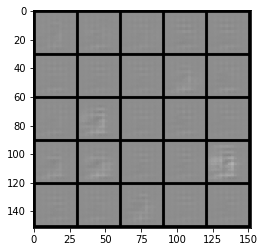

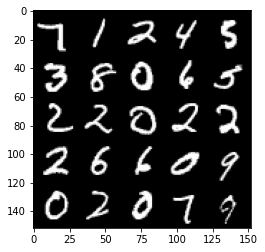

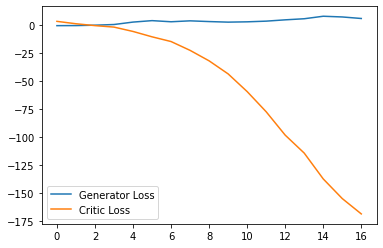

Step 400: Generator loss: 7.502894353866577, critic loss: -221.36967999267577


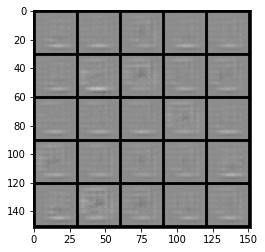

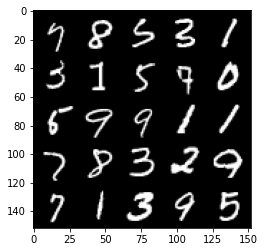

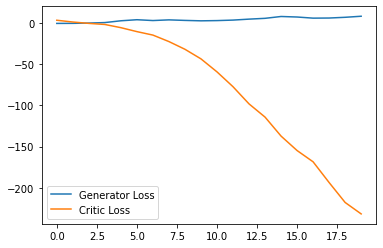

Step 450: Generator loss: 6.149256057739258, critic loss: -271.1360029907227


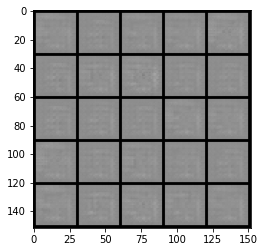

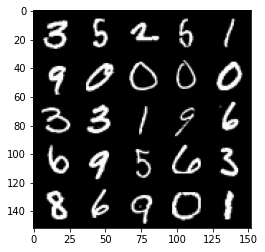

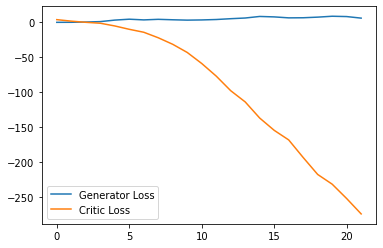

Step 500: Generator loss: 8.570811576843262, critic loss: -329.3606727294922


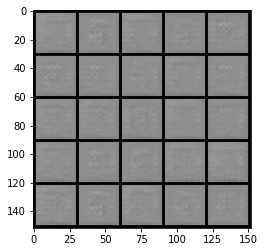

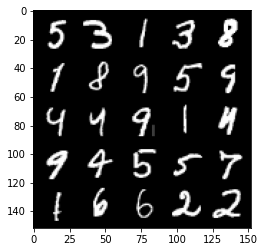

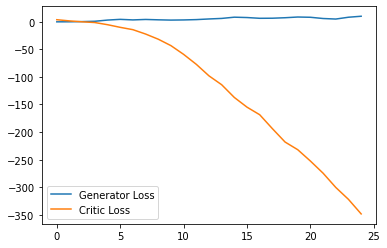

Step 550: Generator loss: 12.453560543060302, critic loss: -381.82191430664056


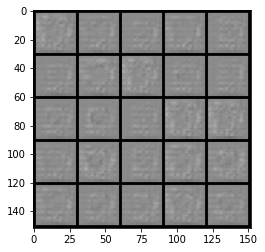

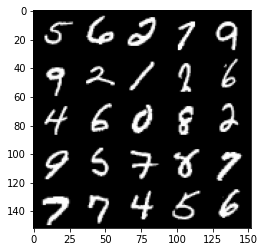

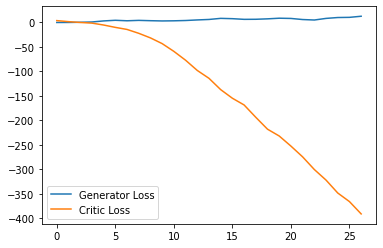

Step 600: Generator loss: 18.103088161945344, critic loss: -421.77649957275395


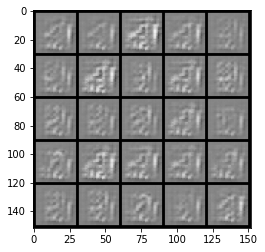

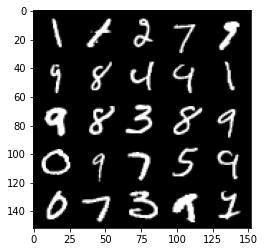

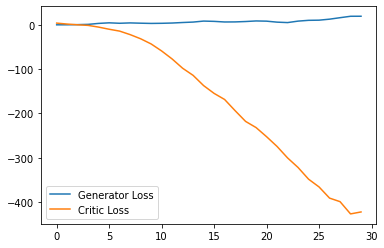

Step 650: Generator loss: 20.176447219848633, critic loss: -445.7996458129882


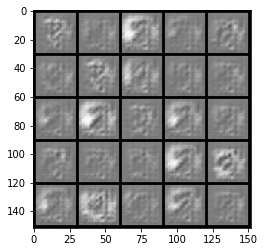

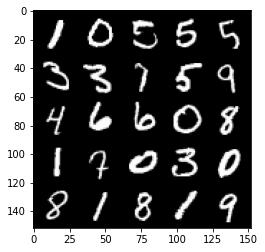

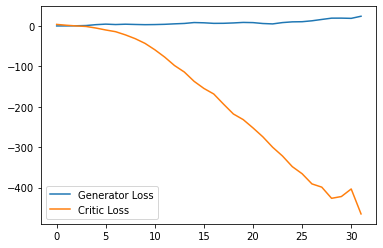

Step 700: Generator loss: 10.986943745613098, critic loss: -525.6178176269531


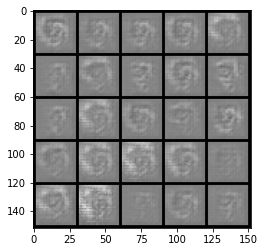

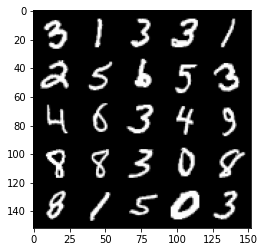

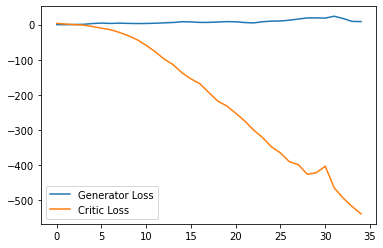

Step 750: Generator loss: 9.353684663772583, critic loss: -541.2370539550782


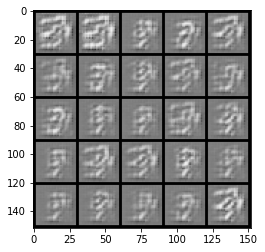

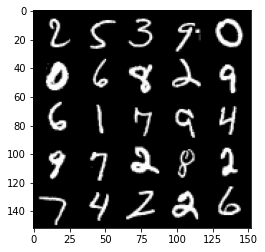

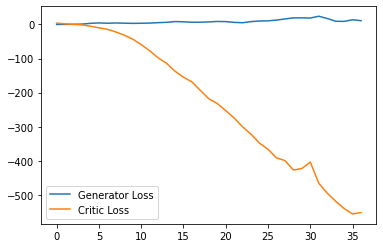

Step 800: Generator loss: -7.477116802930832, critic loss: -483.05781933593767


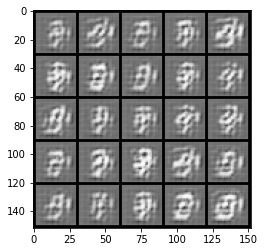

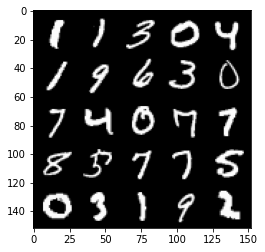

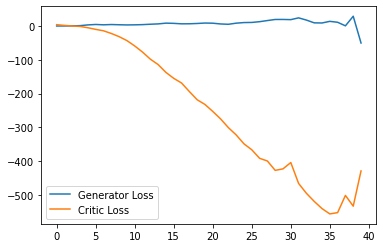

Step 850: Generator loss: -19.463949472904204, critic loss: -402.1473416137697


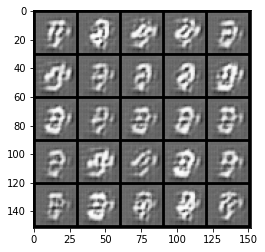

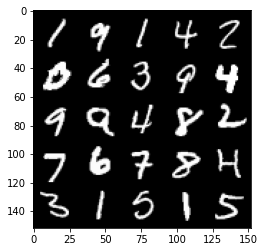

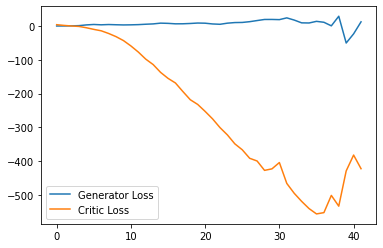

Step 900: Generator loss: 13.389991240501404, critic loss: -429.04984338378904


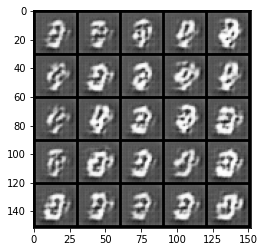

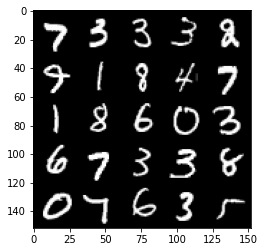

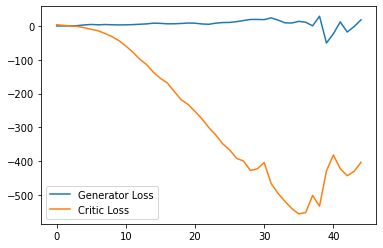

Step 950: Generator loss: -12.900588121414184, critic loss: -306.021384765625


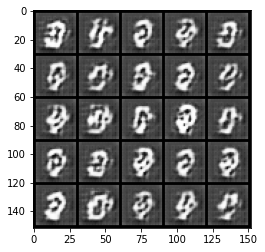

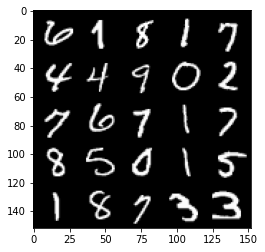

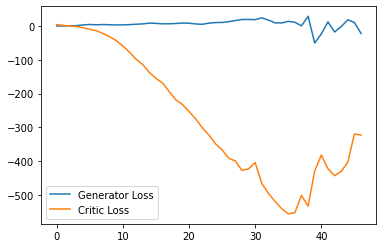

Step 1000: Generator loss: -23.957294286489486, critic loss: -184.65897311401363


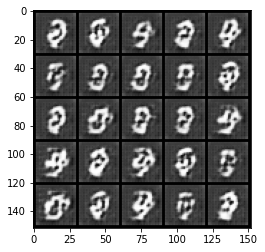

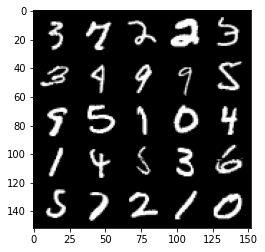

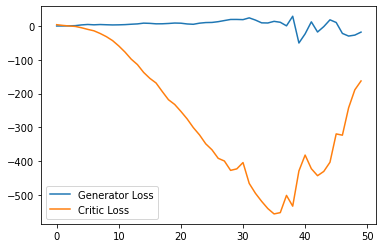

Step 1050: Generator loss: -38.45987958431244, critic loss: -198.2398357849121


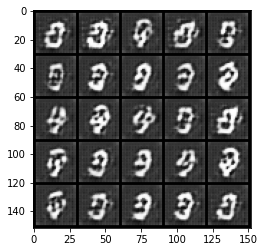

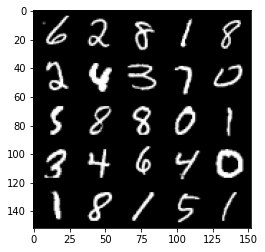

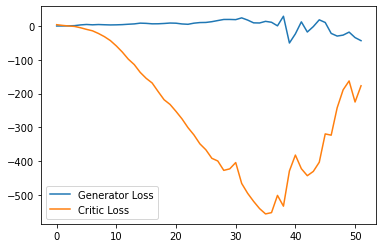

Step 1100: Generator loss: -32.805014259815216, critic loss: -76.30462721252437


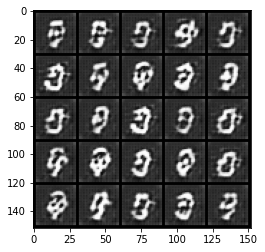

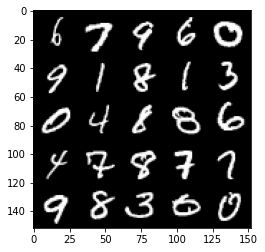

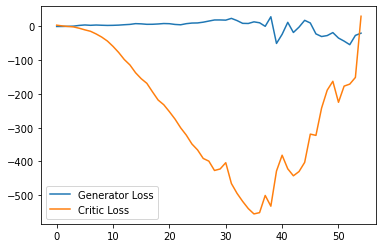

Step 1150: Generator loss: -66.939234765172, critic loss: -46.1547508239746


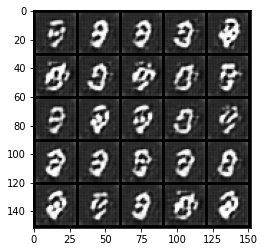

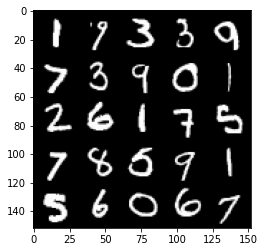

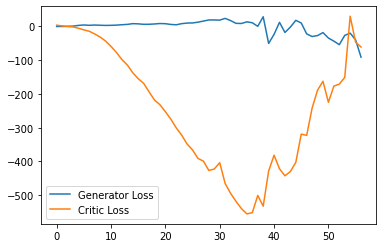

Step 1200: Generator loss: -10.770493105053902, critic loss: 6.055658111572265


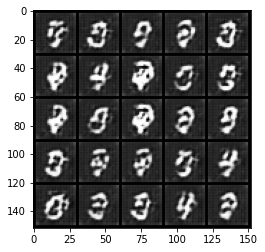

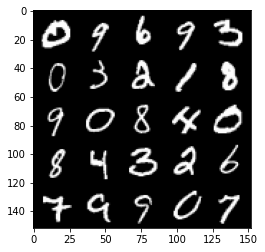

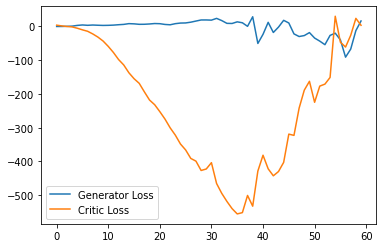

Step 1250: Generator loss: -52.11193244934082, critic loss: -27.529992126464848


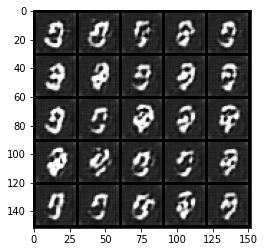

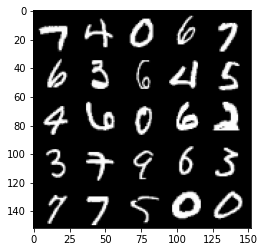

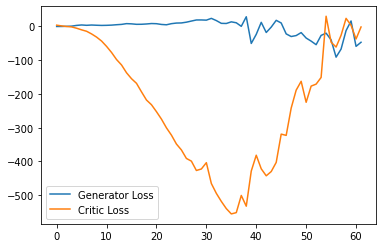

Step 1300: Generator loss: -40.80803795278072, critic loss: 1.2925332336425817


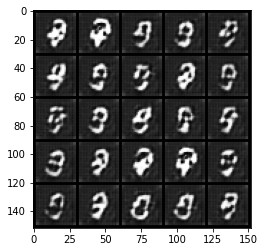

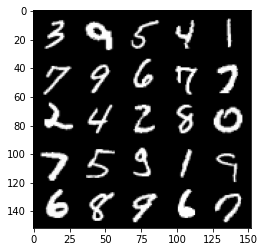

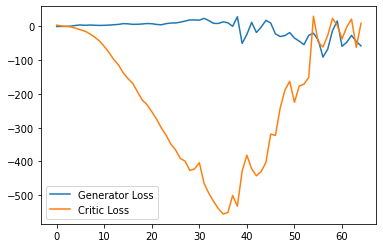

Step 1350: Generator loss: 8.113514847755432, critic loss: 121.61797613525395


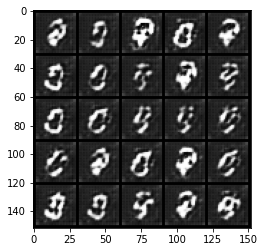

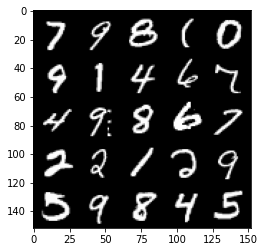

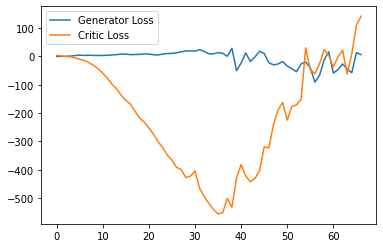

Step 1400: Generator loss: 0.5306905555725098, critic loss: 51.19506253051759


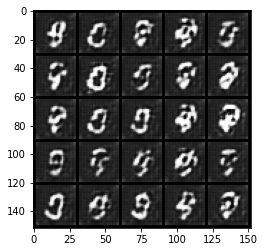

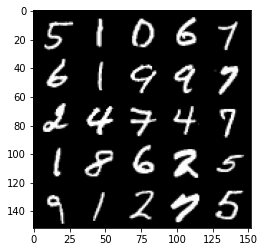

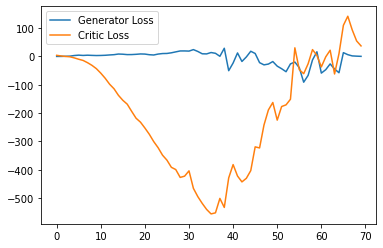

Step 1450: Generator loss: 0.838237419128418, critic loss: 32.77782647705077


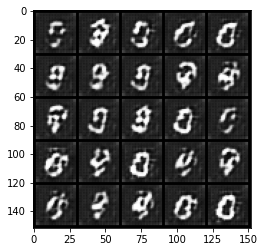

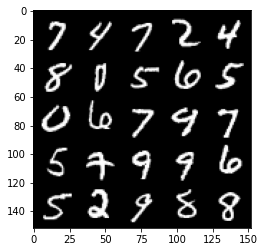

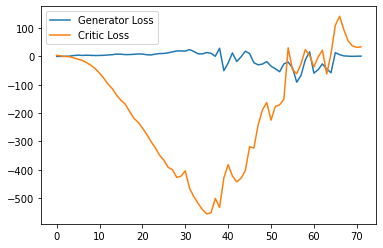

Step 1500: Generator loss: 1.7320995914936066, critic loss: 43.0471907043457


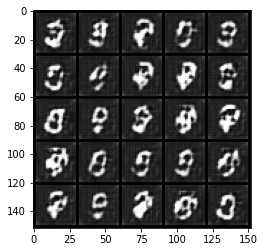

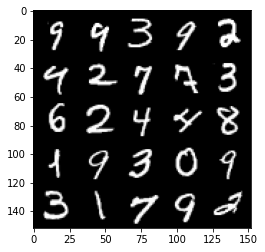

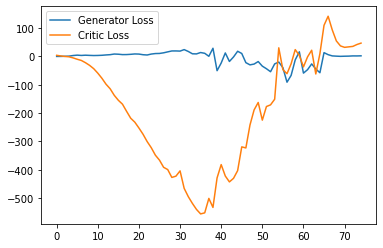

Step 1550: Generator loss: 2.143333172798157, critic loss: 55.75733190917969


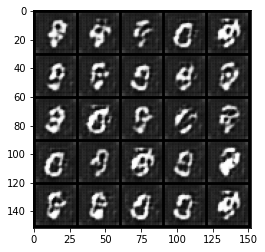

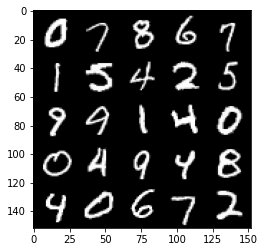

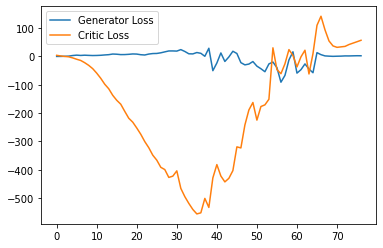

Step 1600: Generator loss: 1.987552810907364, critic loss: 63.115418762207035


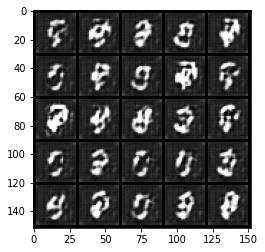

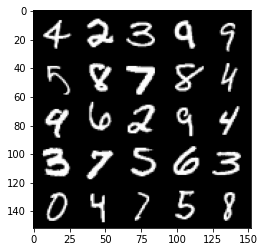

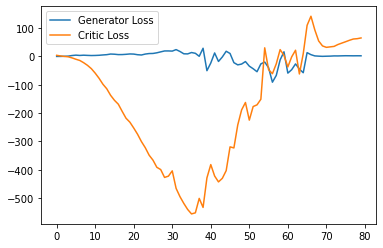

Step 1650: Generator loss: 1.962992808818817, critic loss: 70.98348176574709


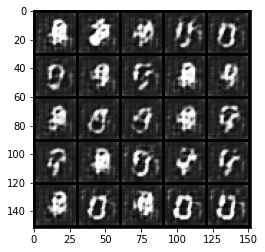

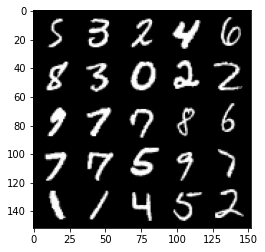

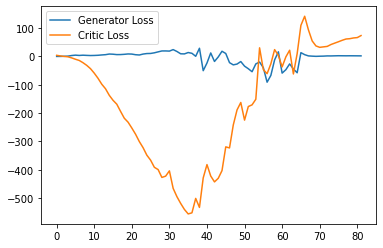

Step 1700: Generator loss: 2.913445173501968, critic loss: 66.98814985656738


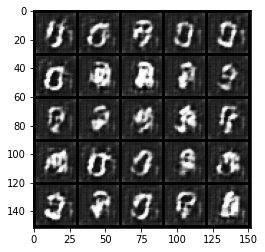

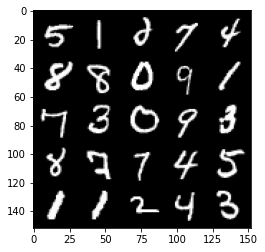

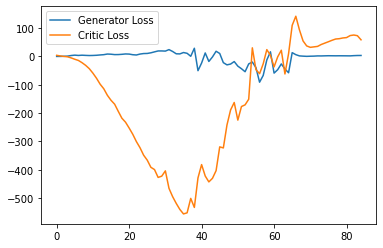

Step 1750: Generator loss: 3.756411018371582, critic loss: 44.25318902587891


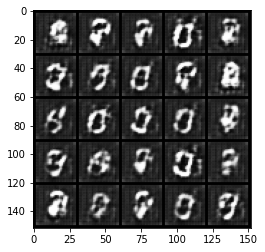

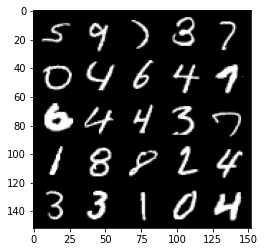

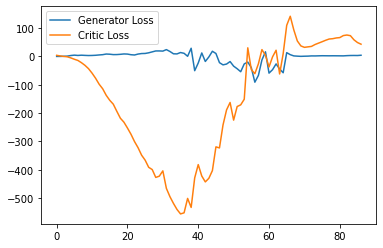

Step 1800: Generator loss: 6.045762286186219, critic loss: 32.67780764770507


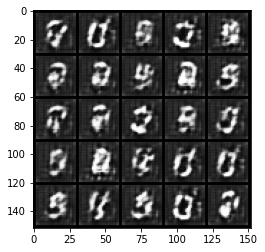

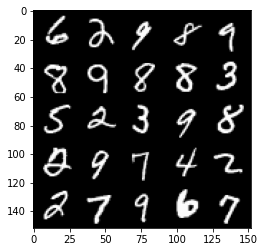

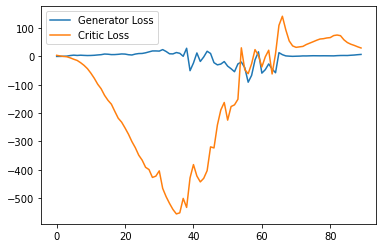

Step 1850: Generator loss: 7.593963460922241, critic loss: 18.288187534332277


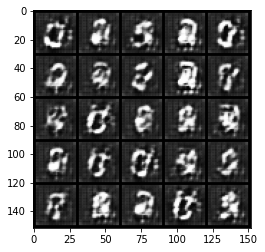

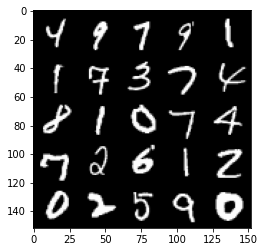

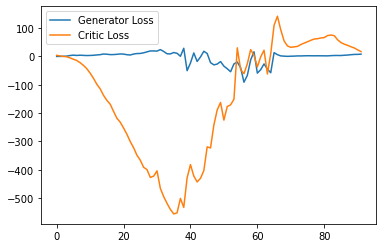

Step 1900: Generator loss: 9.831976709365845, critic loss: 10.050194393157962


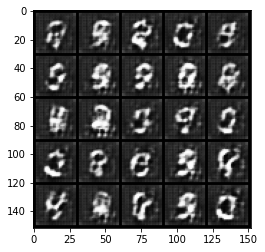

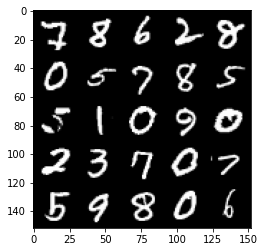

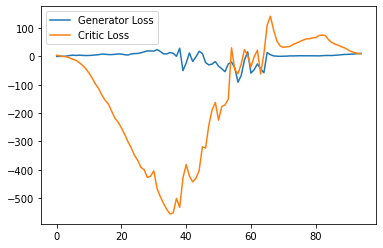

Step 1950: Generator loss: 11.615367107391357, critic loss: 6.883716735839841


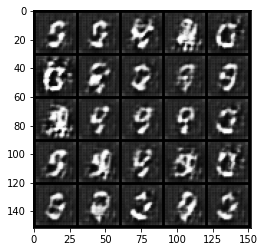

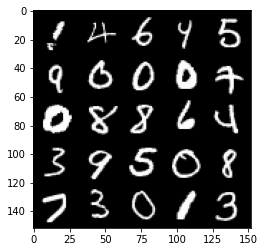

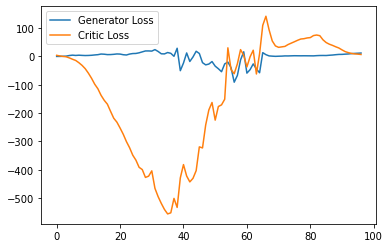

Step 2000: Generator loss: 13.19603105545044, critic loss: 4.655151222229003


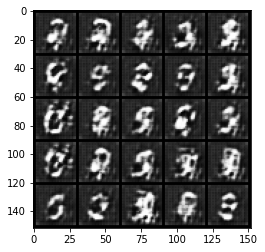

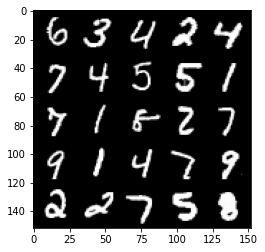

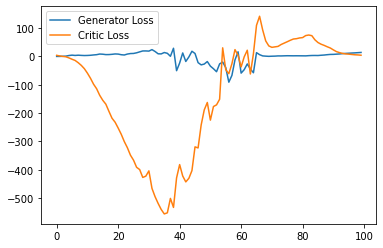

Step 2050: Generator loss: 14.257915859222413, critic loss: 2.8693300056457507


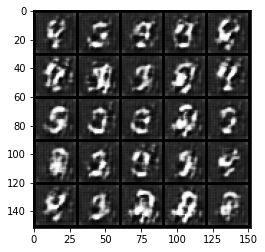

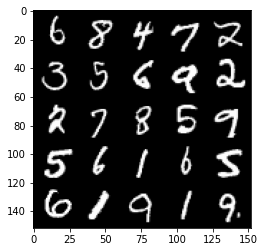

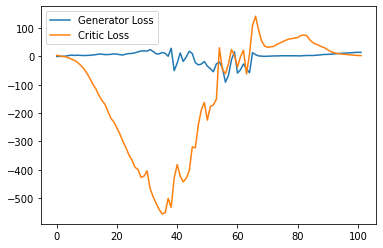

Step 2100: Generator loss: 13.20655023574829, critic loss: 1.684694835662841


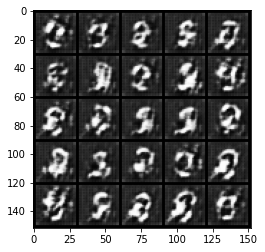

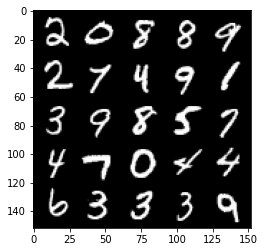

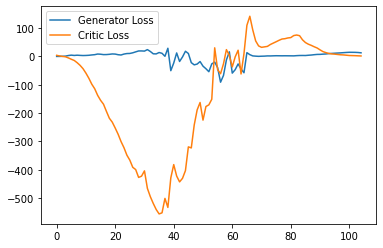

Step 2150: Generator loss: 10.306865520477295, critic loss: 0.45522596931457526


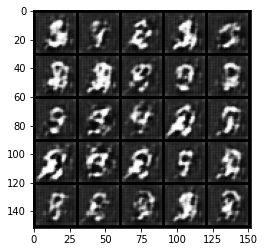

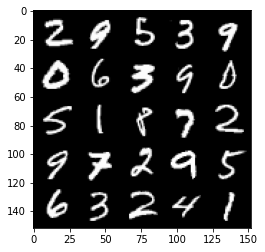

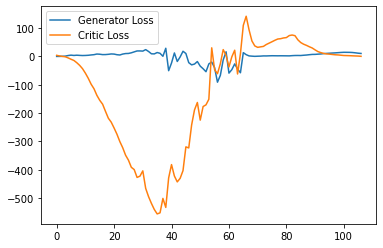

Step 2200: Generator loss: 8.103369541168213, critic loss: -1.2781364021301271


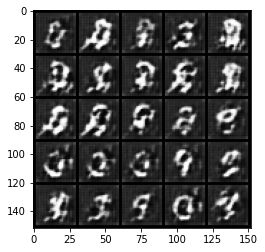

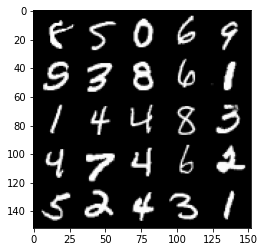

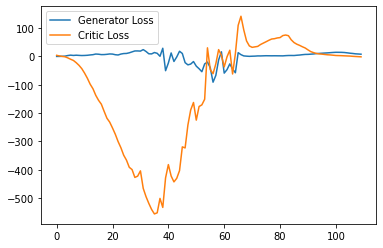

Step 2250: Generator loss: 7.130135450363159, critic loss: -2.559437321662902


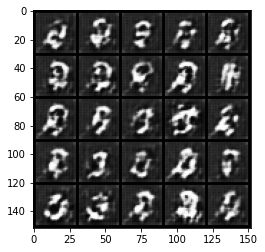

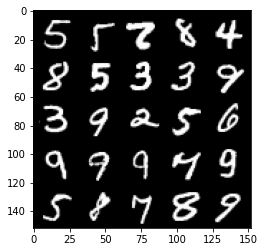

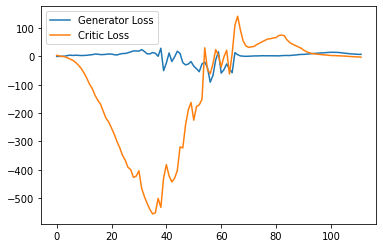

Step 2300: Generator loss: 7.5396119976043705, critic loss: -3.5996460762023936


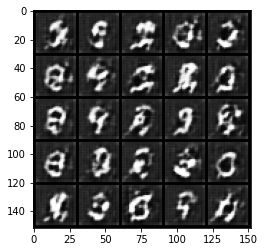

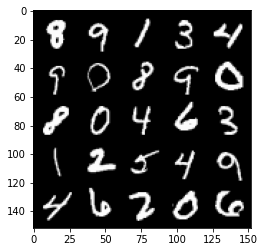

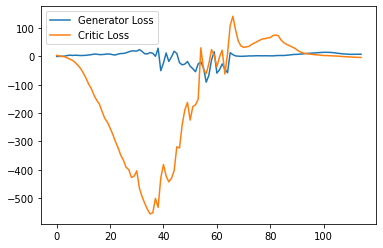

Step 2350: Generator loss: 7.557834873199463, critic loss: -4.768472867965698


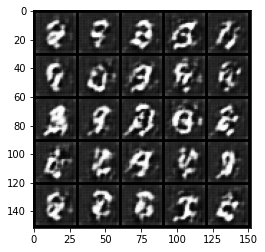

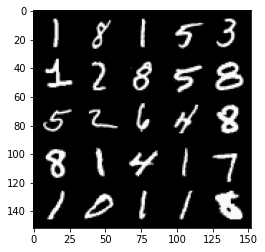

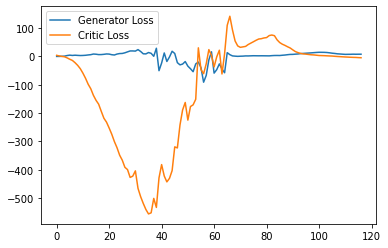

Step 2400: Generator loss: 6.5957254433631896, critic loss: -6.729143135070801


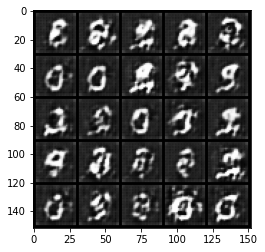

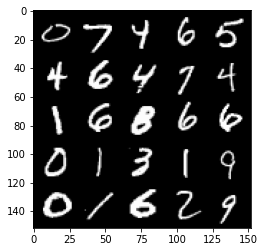

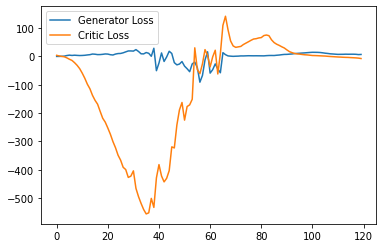

Step 2450: Generator loss: 6.500551264286042, critic loss: -9.781664001464847


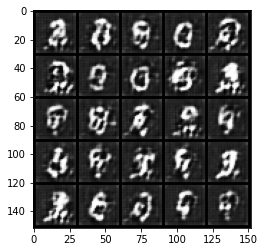

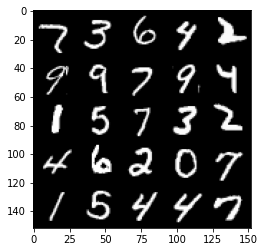

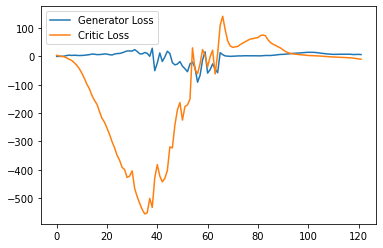

Step 2500: Generator loss: 7.541502540111542, critic loss: -12.046334272384643


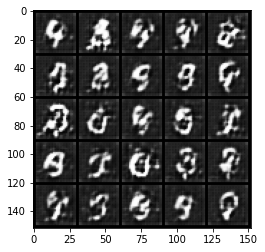

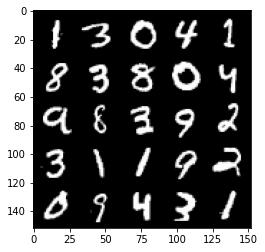

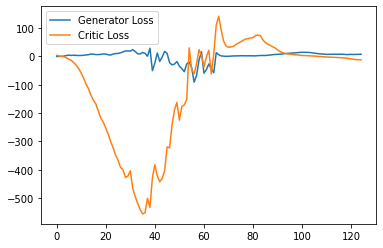

Step 2550: Generator loss: 8.319471492767335, critic loss: -13.17949520111084


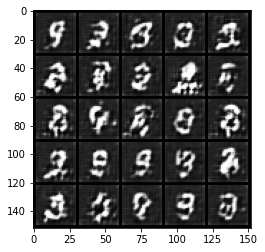

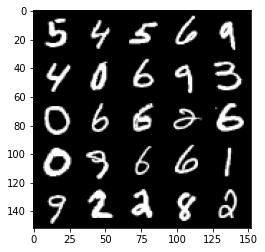

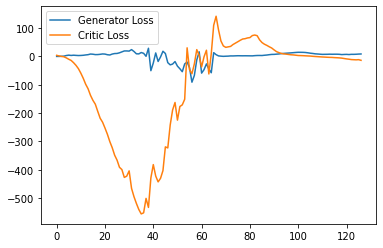

Step 2600: Generator loss: 11.017377586364747, critic loss: -14.12983828163147


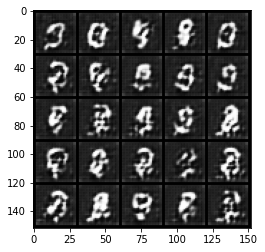

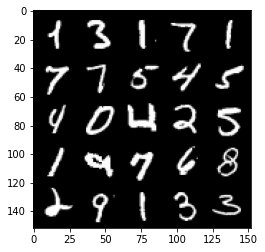

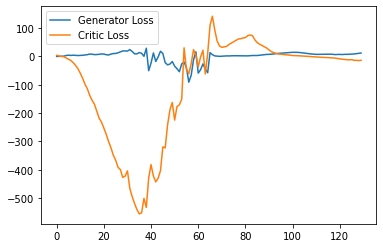

Step 2650: Generator loss: 13.590482139587403, critic loss: -15.299407066345218


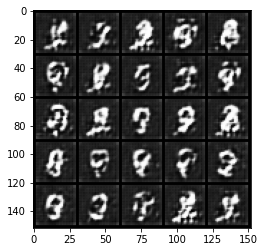

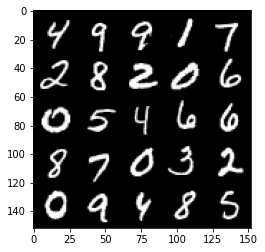

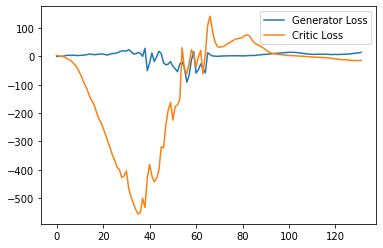

Step 2700: Generator loss: 16.37701997756958, critic loss: -14.706835058212283


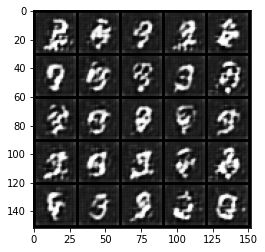

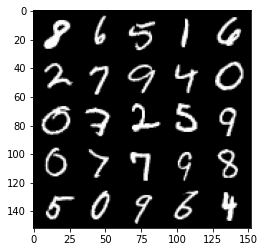

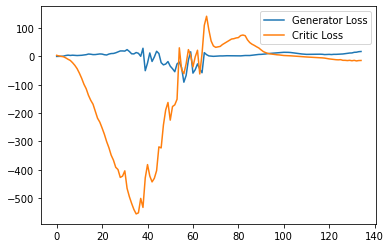

Step 2750: Generator loss: 18.090896892547608, critic loss: -15.271909248352053


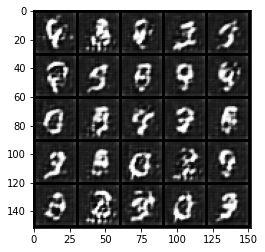

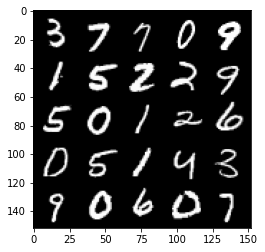

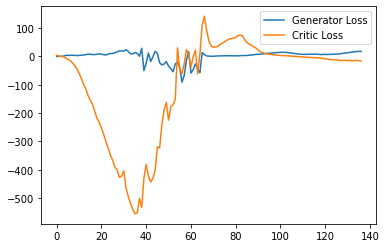

Step 2800: Generator loss: 19.794314155578615, critic loss: -16.919023876190185


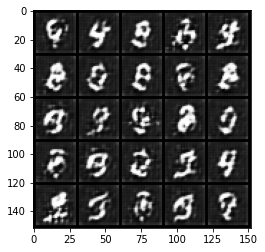

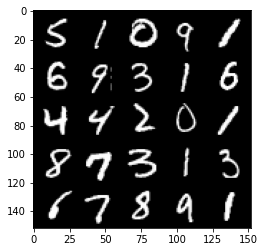

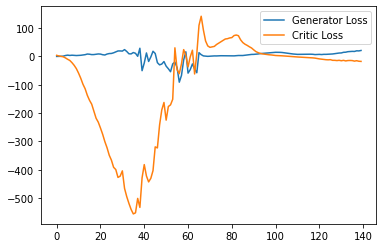

Step 2850: Generator loss: 22.17768970489502, critic loss: -14.939443386077883


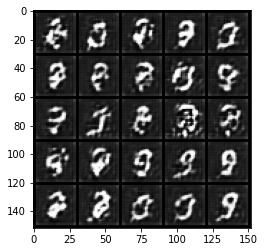

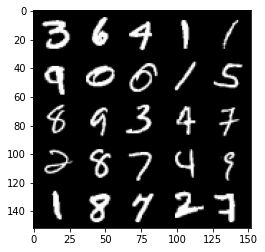

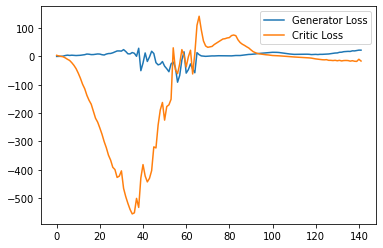

Step 2900: Generator loss: 23.83674503326416, critic loss: -18.145595252990717


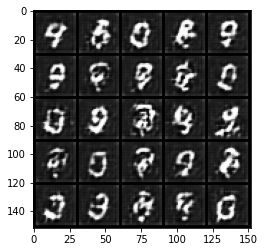

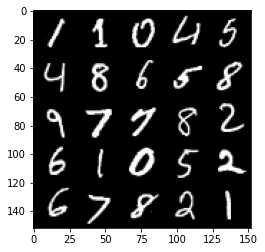

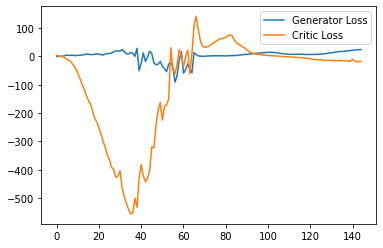

Step 2950: Generator loss: 25.367415771484374, critic loss: -17.691330778121948


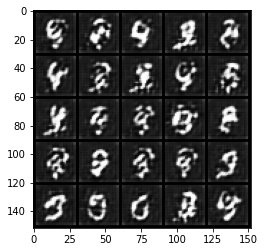

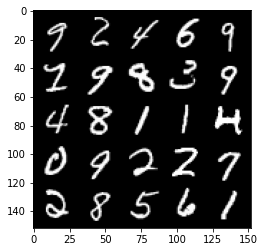

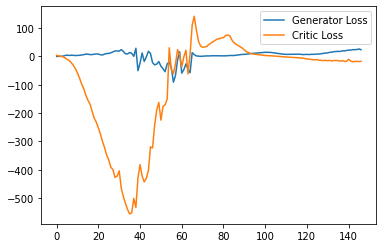

Step 3000: Generator loss: 25.612521209716796, critic loss: -18.60664846038818


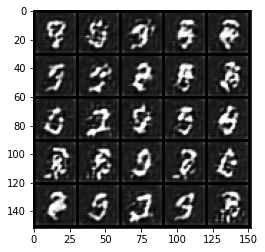

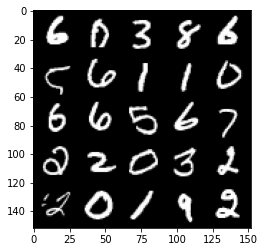

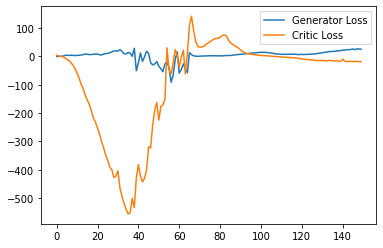

Step 3050: Generator loss: 28.233556632995604, critic loss: -19.280090866088862


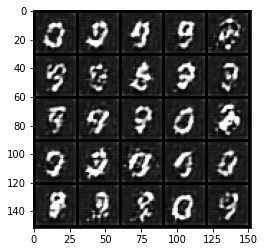

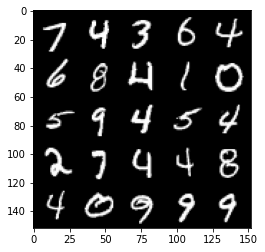

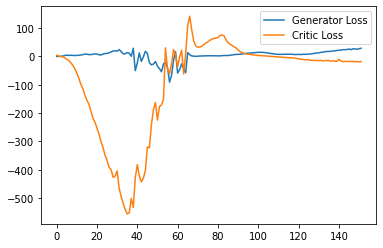

Step 3100: Generator loss: 28.608250312805175, critic loss: -16.15163954925537


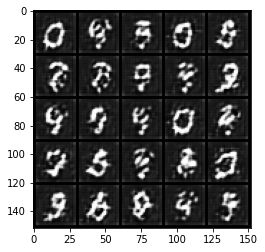

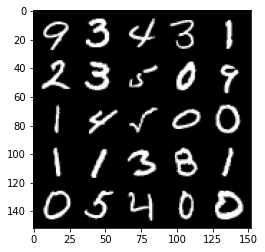

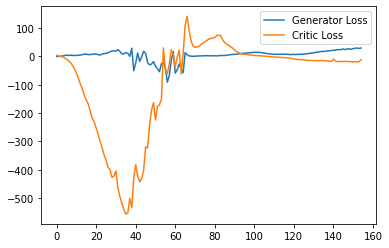

Step 3150: Generator loss: 28.352594757080077, critic loss: -18.073173313140863


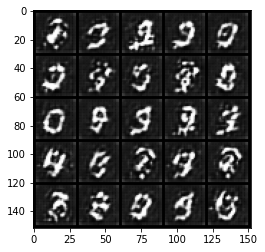

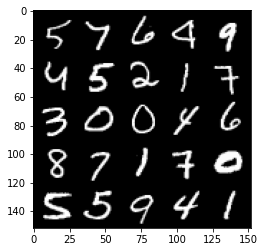

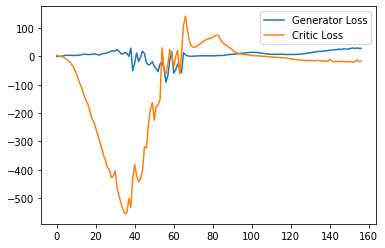

Step 3200: Generator loss: 31.437500877380373, critic loss: -18.938505422592158


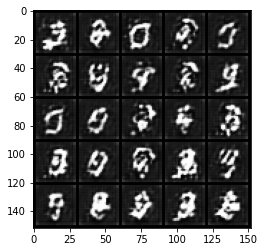

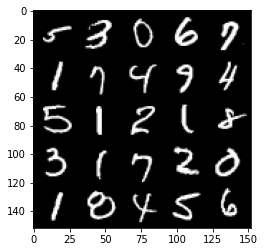

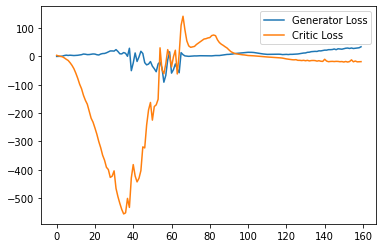

Step 3250: Generator loss: 32.493937950134274, critic loss: -19.08379828071594


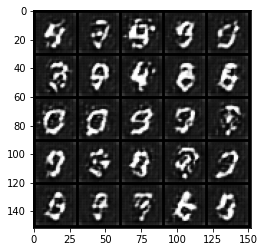

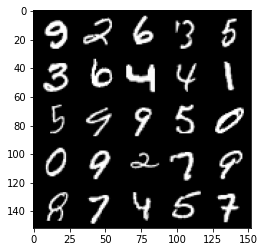

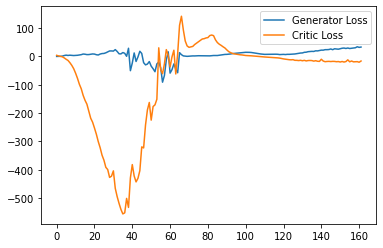

Step 3300: Generator loss: 33.68756576538086, critic loss: -19.32936032867432


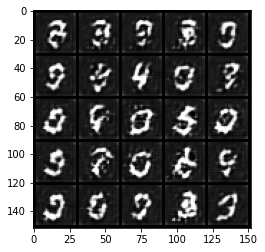

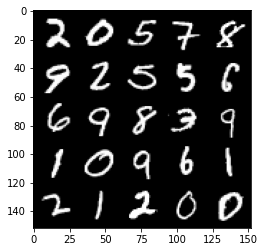

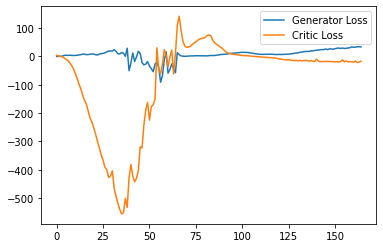

Step 3350: Generator loss: 34.34878025054932, critic loss: -19.728295442581178


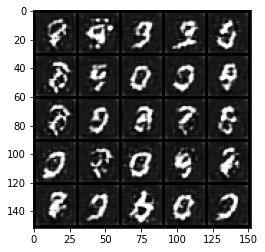

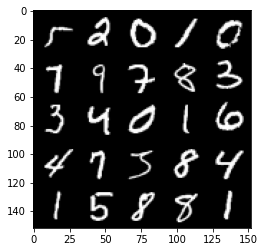

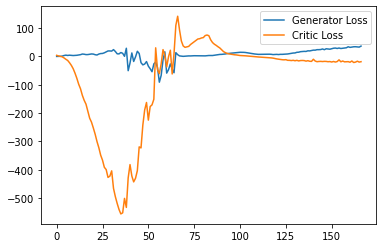

Step 3400: Generator loss: 36.3071821975708, critic loss: -20.62393928909302


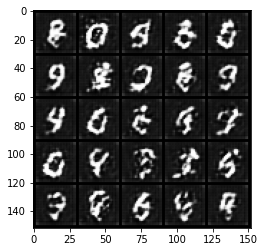

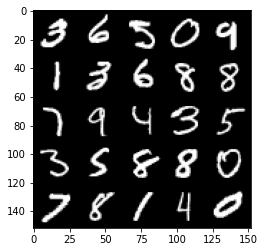

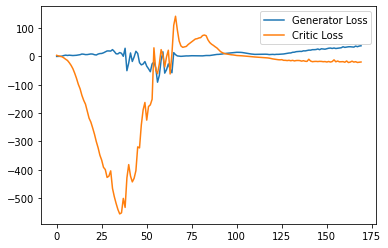

Step 3450: Generator loss: 37.976624183654785, critic loss: -21.055235044479367


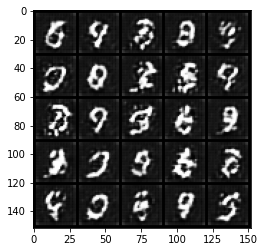

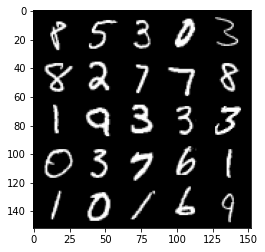

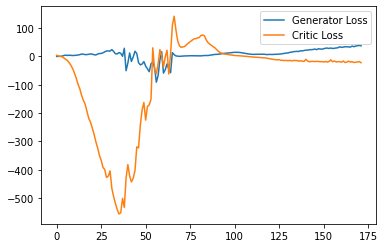

Step 3500: Generator loss: 38.34088996887207, critic loss: -19.029453111648557


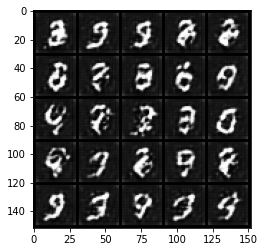

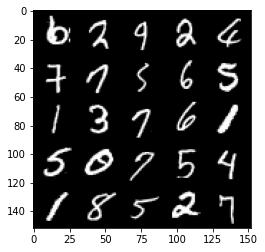

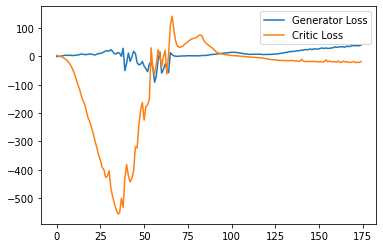

Step 3550: Generator loss: 41.27563102722168, critic loss: -16.578409588813784


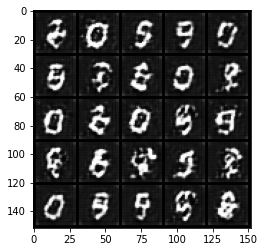

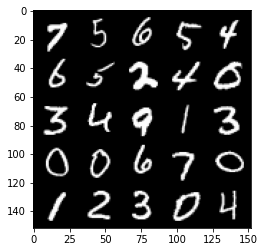

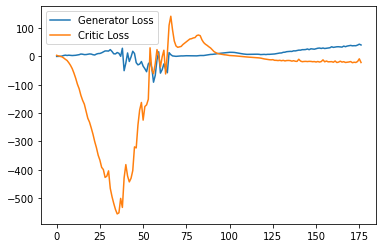

Step 3600: Generator loss: 41.86267402648926, critic loss: -20.93623755264282


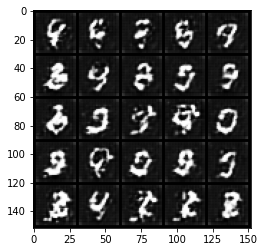

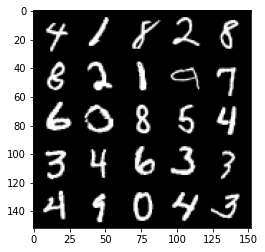

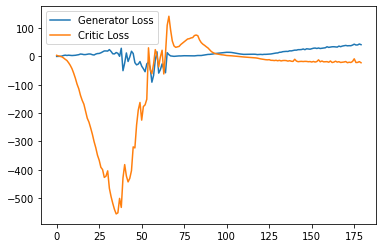

Step 3650: Generator loss: 44.48216697692871, critic loss: -17.7644535522461


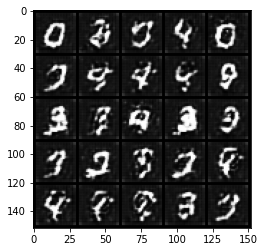

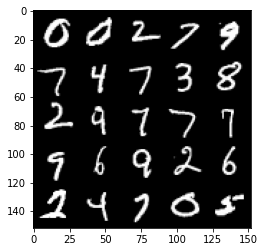

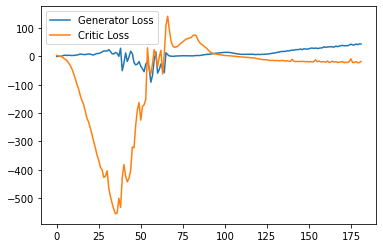

Step 3700: Generator loss: 43.836766204833985, critic loss: -19.339186672210687


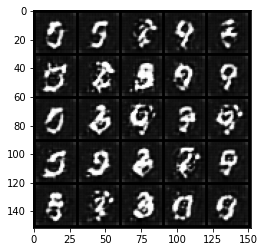

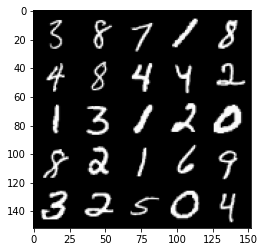

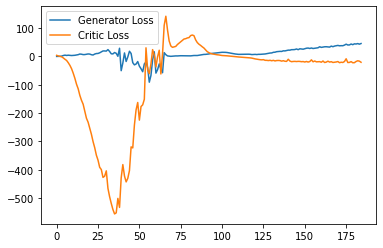

Step 3750: Generator loss: 44.24303550720215, critic loss: -22.362809097290043


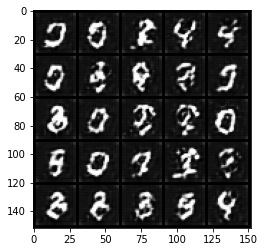

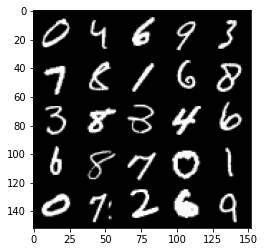

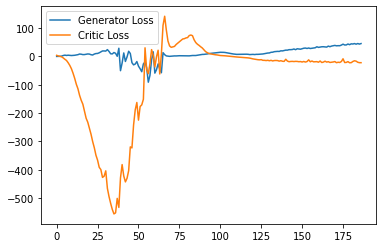

Step 3800: Generator loss: 45.25895244598389, critic loss: -18.258234520912172


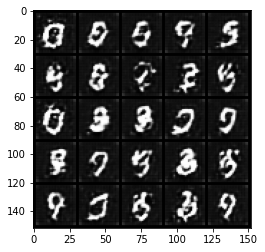

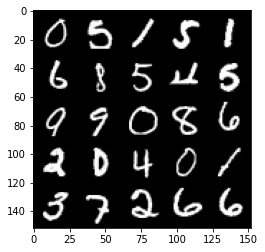

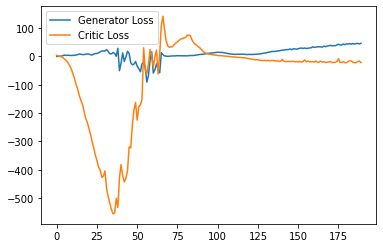

Step 3850: Generator loss: 46.72435501098633, critic loss: -21.57978572845459


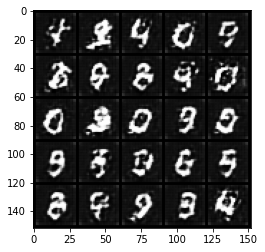

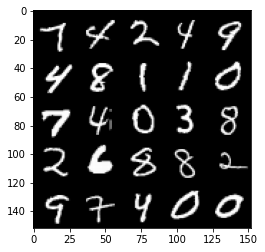

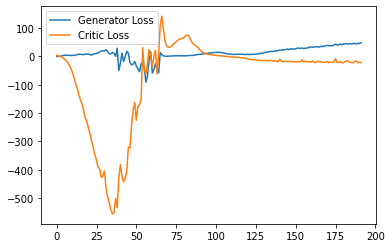

Step 3900: Generator loss: 48.4462809753418, critic loss: -17.500376466751096


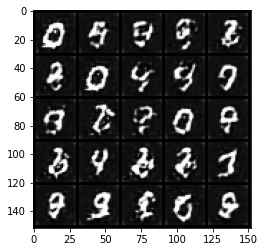

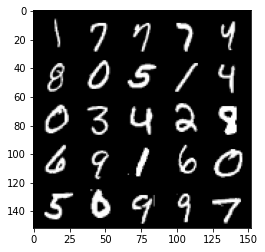

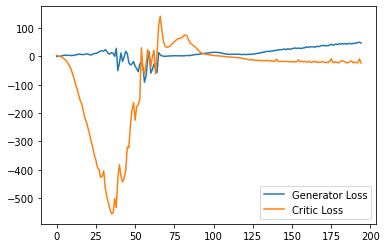

Step 3950: Generator loss: 49.09221282958984, critic loss: -20.186631990432737


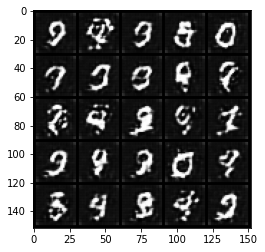

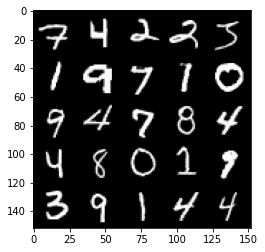

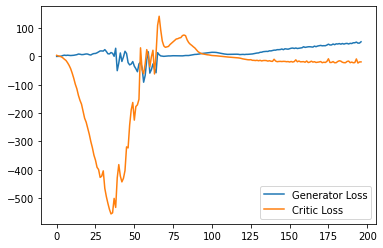

Step 4000: Generator loss: 49.44602188110352, critic loss: -21.650907562255856


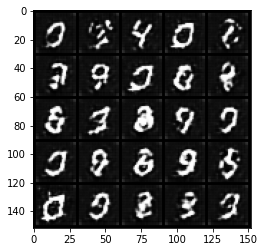

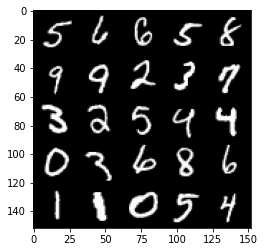

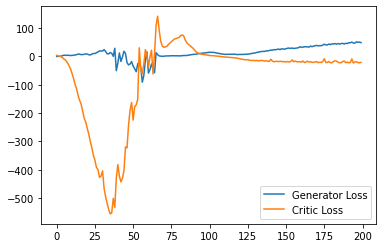

Step 4050: Generator loss: 51.508676071166995, critic loss: -22.902993120193482


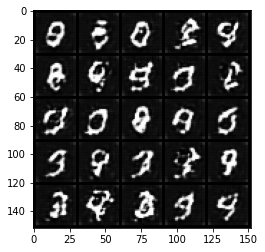

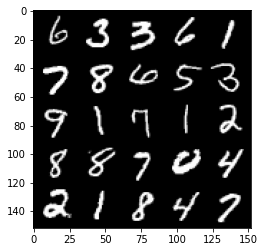

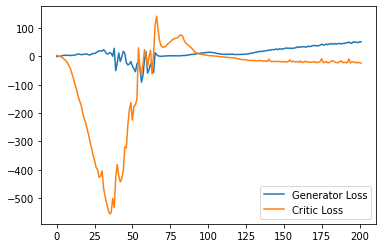

Step 4100: Generator loss: 51.236454010009766, critic loss: -20.609116043090822


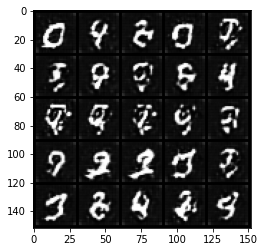

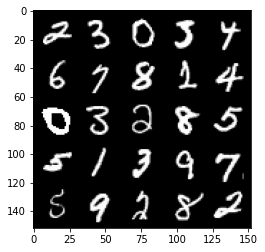

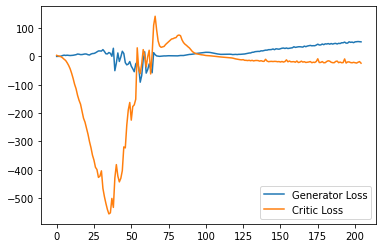

Step 4150: Generator loss: 54.4948811340332, critic loss: -16.124527560234068


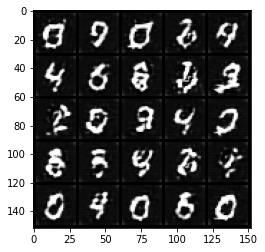

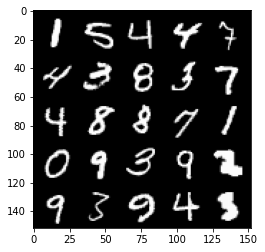

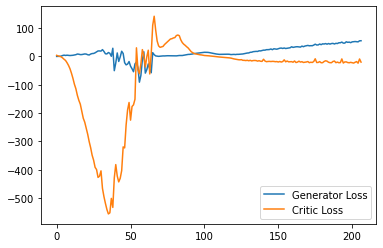

Step 4200: Generator loss: 53.09237495422363, critic loss: -21.409776277542115


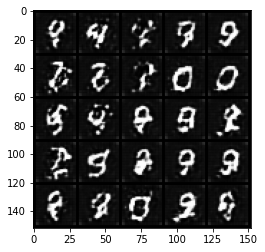

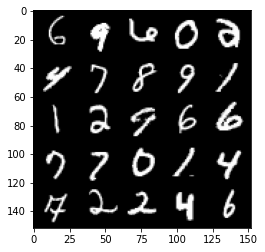

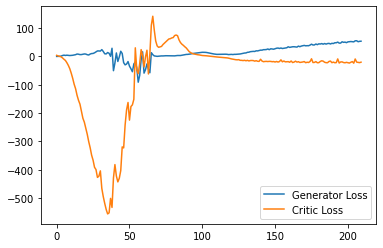

Step 4250: Generator loss: 57.694578094482424, critic loss: -11.518345840454101


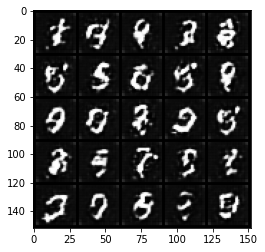

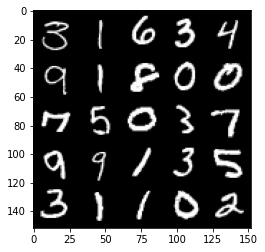

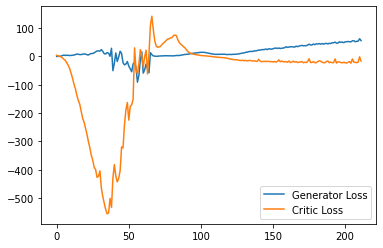

Step 4300: Generator loss: 55.379926681518555, critic loss: -20.34566488647461


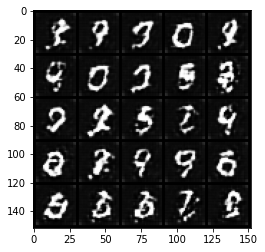

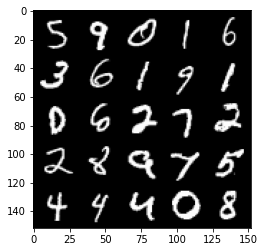

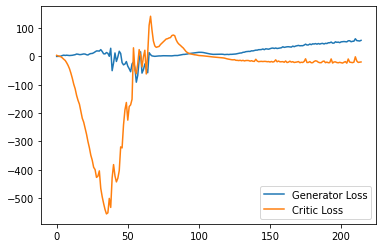

Step 4350: Generator loss: 55.57645240783691, critic loss: -20.20198515129089


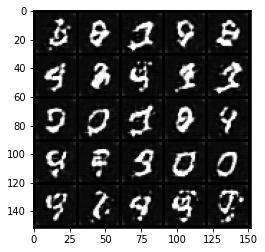

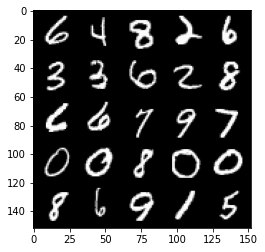

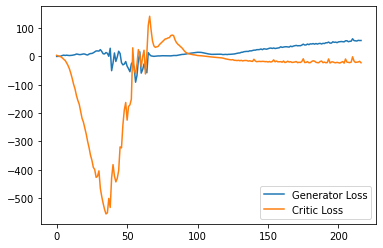

Step 4400: Generator loss: 55.23817268371582, critic loss: -19.7007079372406


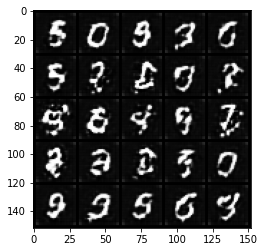

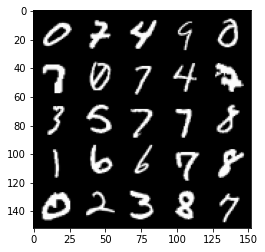

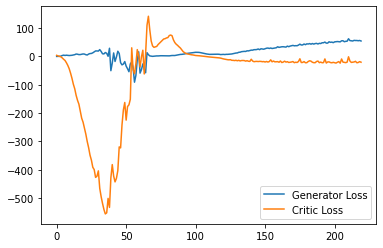

Step 4450: Generator loss: 54.49592193603516, critic loss: -18.452093952178956


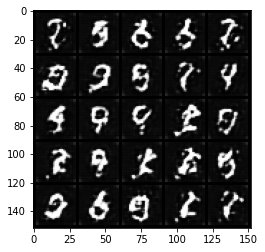

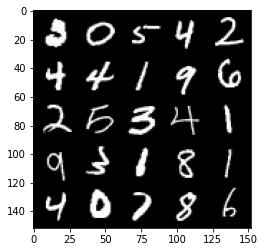

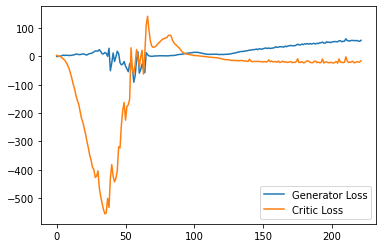

Step 4500: Generator loss: 59.69586082458496, critic loss: -8.63629396533966


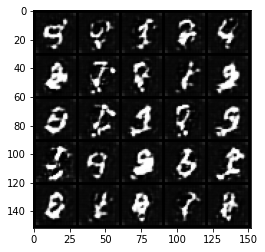

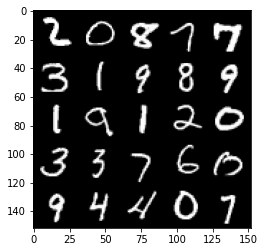

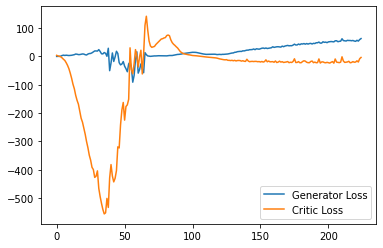

Step 4550: Generator loss: 59.05977180480957, critic loss: -10.653815554618836


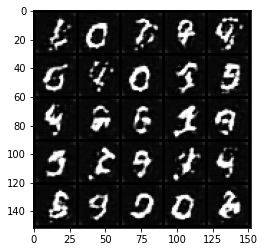

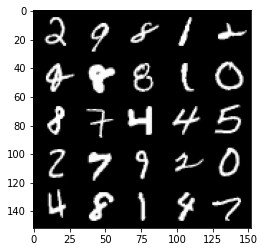

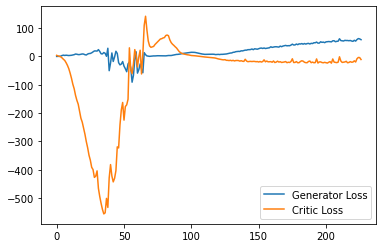

Step 4600: Generator loss: 57.57442626953125, critic loss: -20.595088189125057


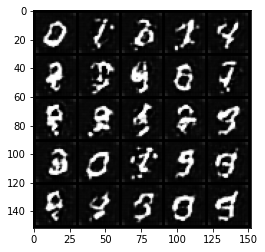

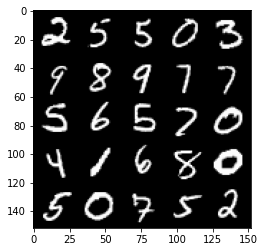

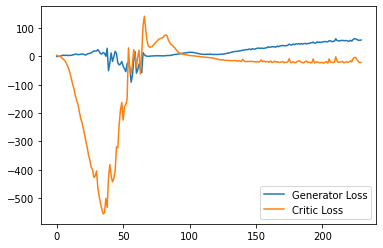

Step 4650: Generator loss: 56.82448570251465, critic loss: -21.282531091690068


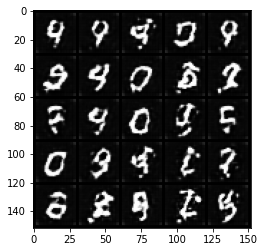

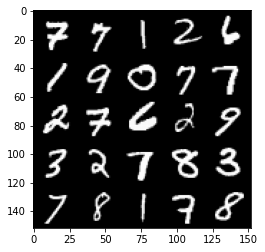

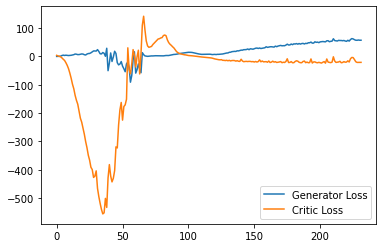

Step 4700: Generator loss: 58.11188102722168, critic loss: -17.43411470031738


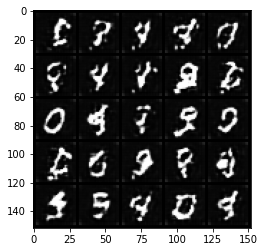

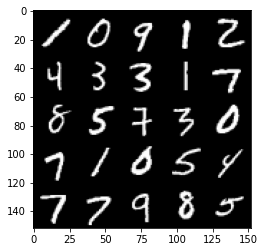

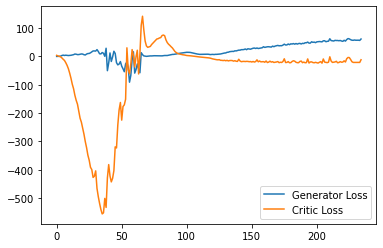

Step 4750: Generator loss: 57.75857452392578, critic loss: -19.868341260910036


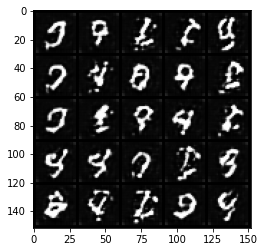

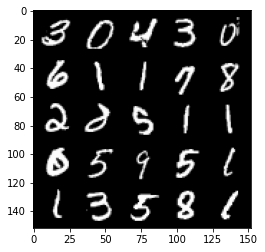

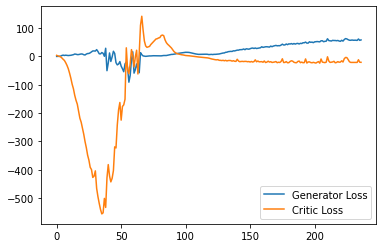

Step 4800: Generator loss: 59.74830909729004, critic loss: -18.75464645004273


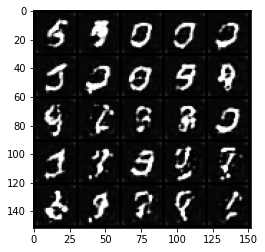

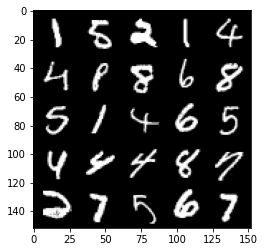

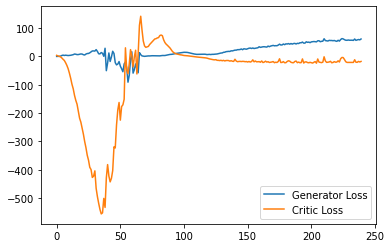

Step 4850: Generator loss: 65.1193627166748, critic loss: -5.159652591228484


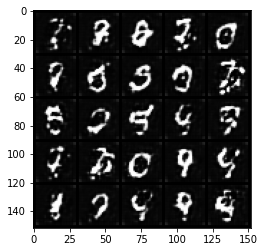

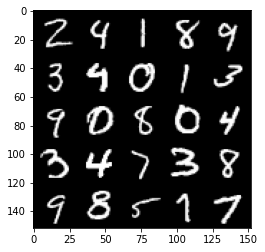

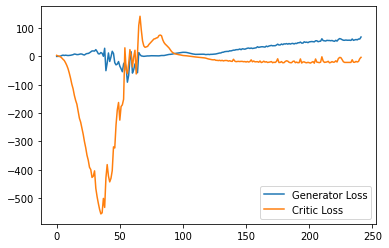

Step 4900: Generator loss: 63.85902900695801, critic loss: -3.9454735240936274


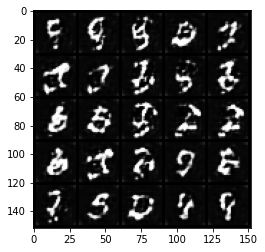

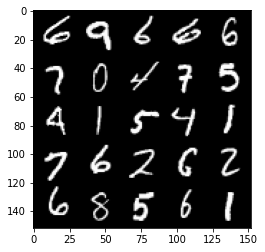

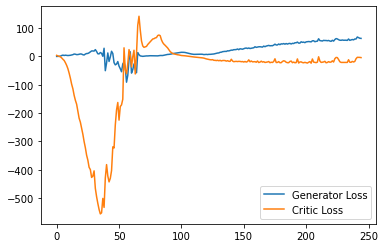

Step 4950: Generator loss: 58.70215423583984, critic loss: -17.492125284194945


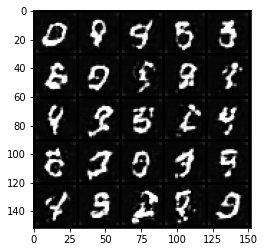

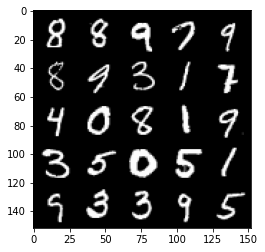

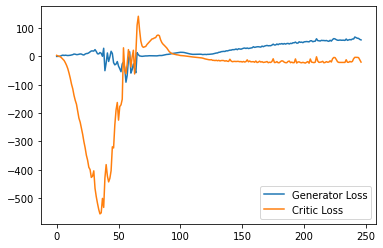

Step 5000: Generator loss: 66.1288988494873, critic loss: -7.152759551525115


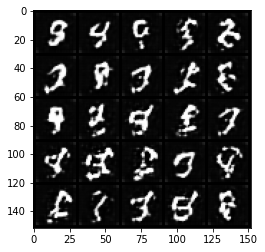

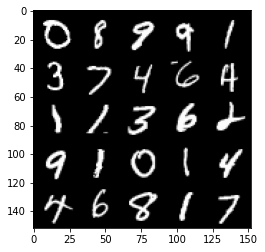

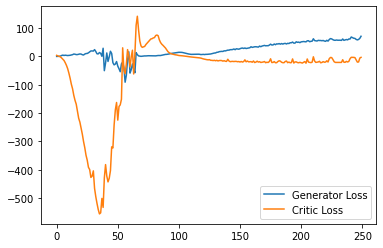

Step 5050: Generator loss: 67.76952255249023, critic loss: -3.616072023391723


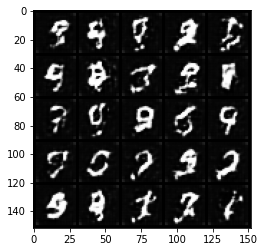

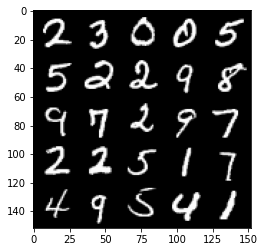

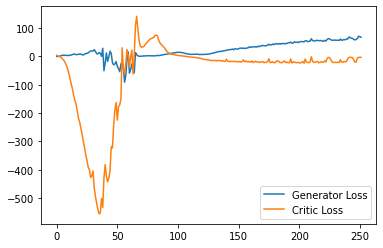

Step 5100: Generator loss: 64.44434852600098, critic loss: -8.154023786544801


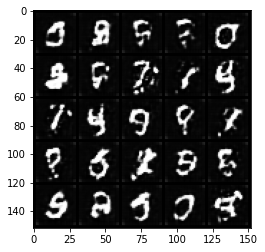

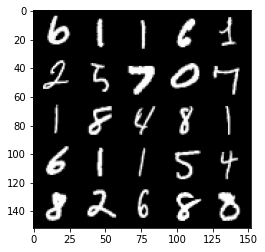

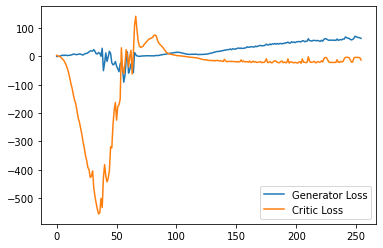

Step 5150: Generator loss: 66.09725601196288, critic loss: -8.238967018127441


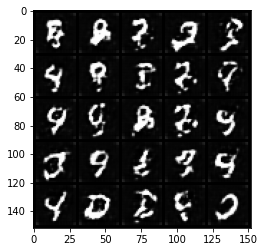

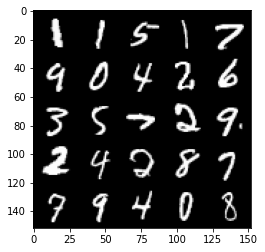

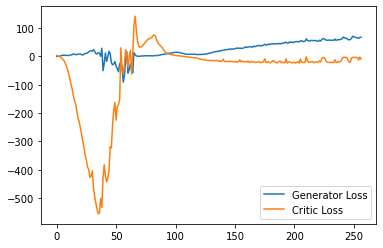

Step 5200: Generator loss: 65.84187812805176, critic loss: -14.03614039993286


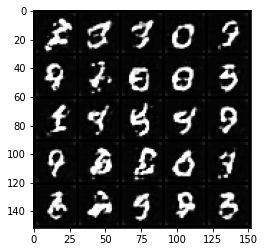

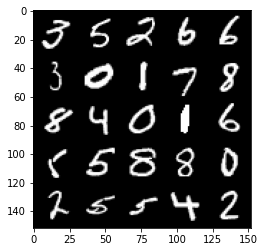

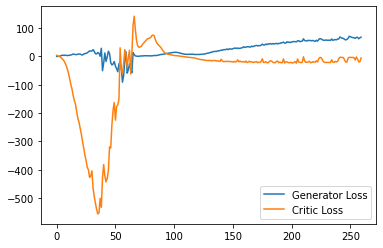

Step 5250: Generator loss: 64.18512855529785, critic loss: -16.811767452716833


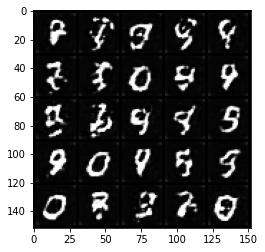

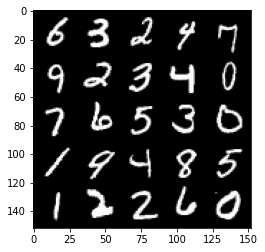

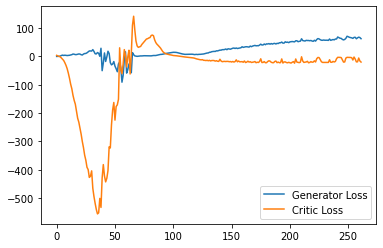

Step 5300: Generator loss: 63.23158432006836, critic loss: -20.098467782020563


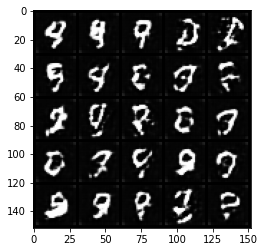

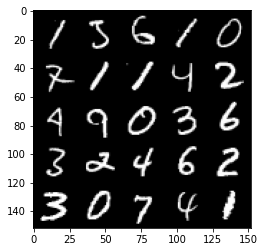

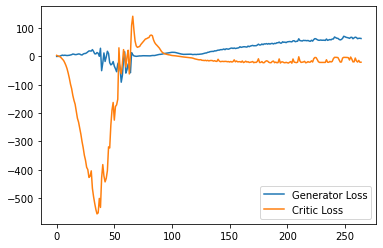

Step 5350: Generator loss: 62.81213088989258, critic loss: -21.7063498840332


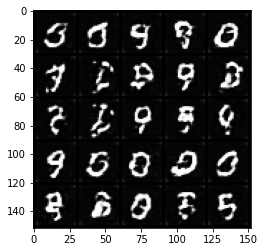

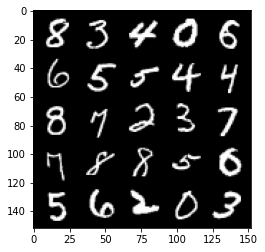

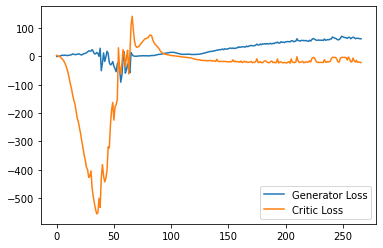

Step 5400: Generator loss: 63.968120651245115, critic loss: -20.20662660598755


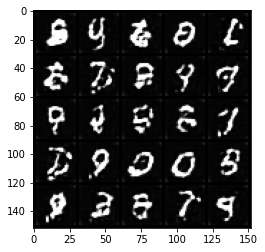

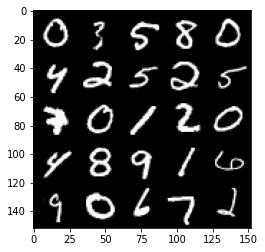

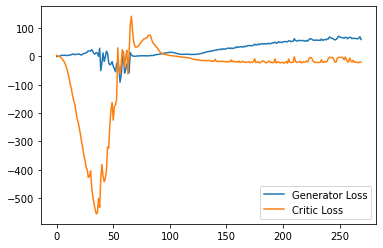

Step 5450: Generator loss: 70.37468338012695, critic loss: -0.15745668697357323


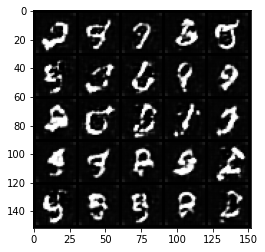

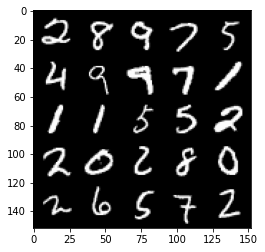

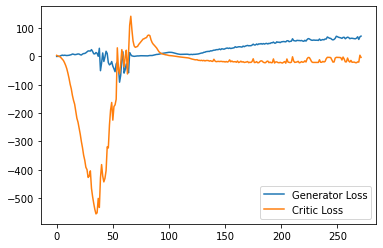

Step 5500: Generator loss: 70.45039733886719, critic loss: -3.851699776649474


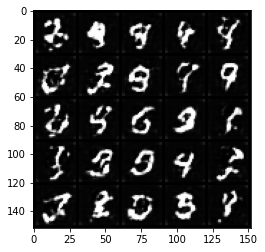

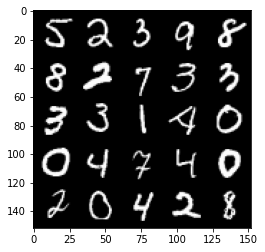

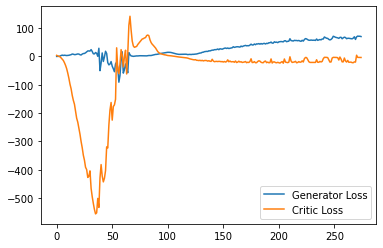

Step 5550: Generator loss: 65.948911819458, critic loss: -9.149415559768677


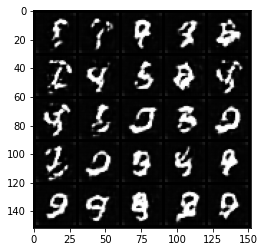

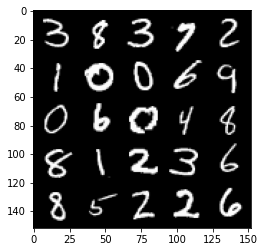

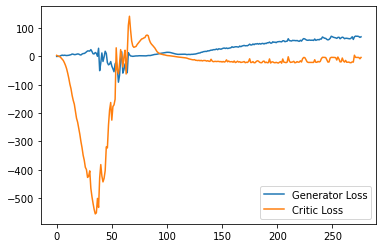

Step 5600: Generator loss: 68.4925447845459, critic loss: -9.650499665260316


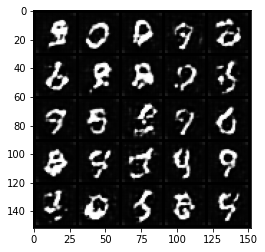

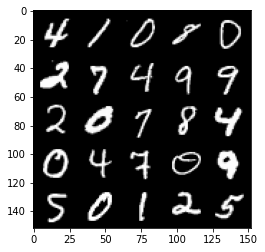

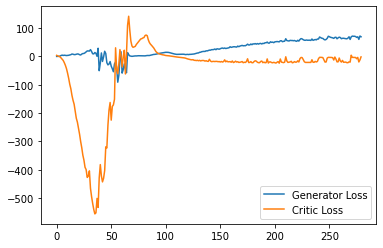

Step 5650: Generator loss: 65.64163047790527, critic loss: -16.272121508598328


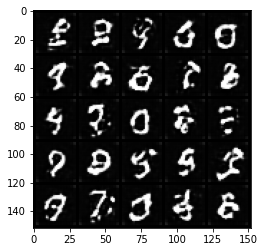

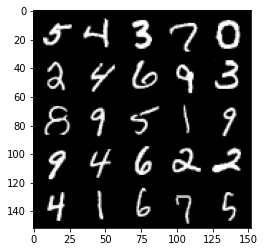

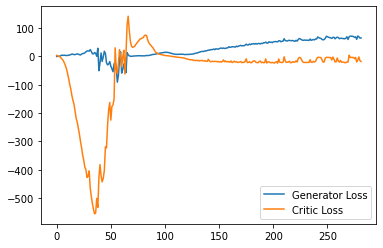

Step 5700: Generator loss: 67.96083335876465, critic loss: -16.17935738658905


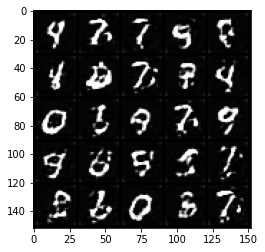

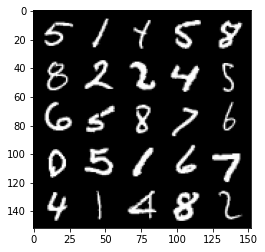

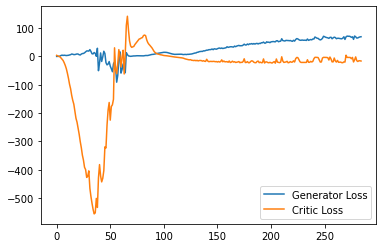

Step 5750: Generator loss: 63.312516403198245, critic loss: -19.076106144905093


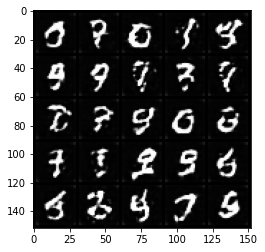

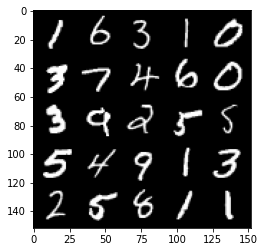

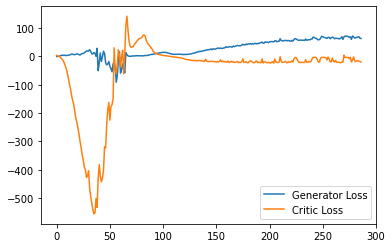

Step 5800: Generator loss: 67.52807174682617, critic loss: -10.49915813922882


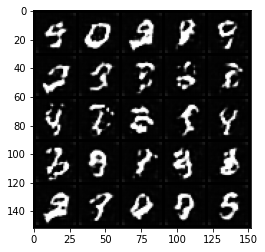

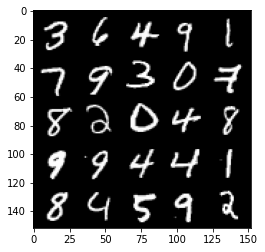

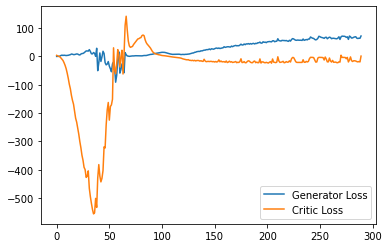

Step 5850: Generator loss: 68.09771743774414, critic loss: -14.813067955017088


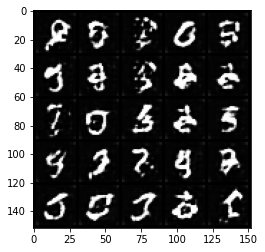

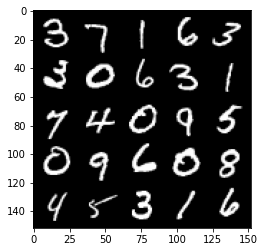

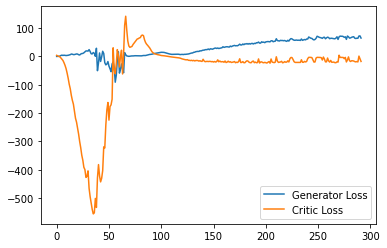

Step 5900: Generator loss: 68.94089233398438, critic loss: -9.34079849910736


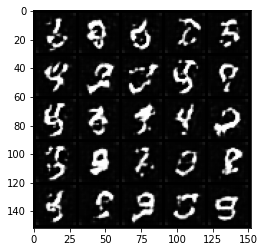

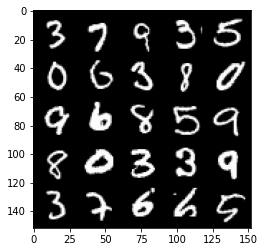

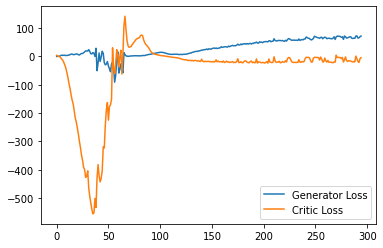

Step 5950: Generator loss: 65.44483207702636, critic loss: -14.702407189369207


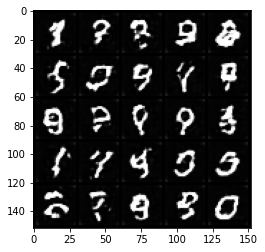

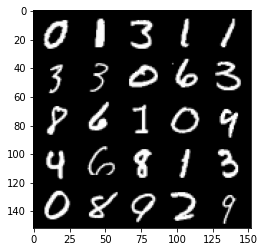

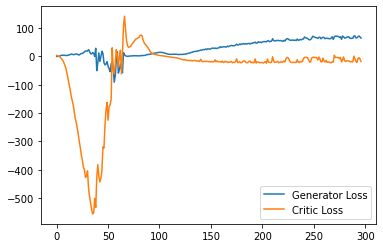

Step 6000: Generator loss: 67.96420501708984, critic loss: -14.04141724586487


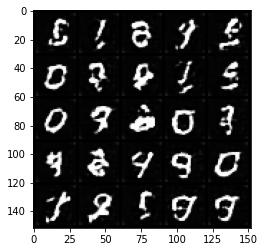

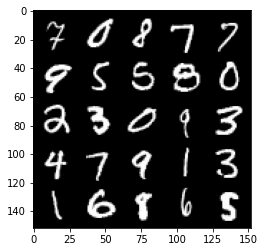

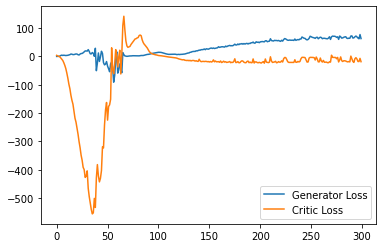

Step 6050: Generator loss: 64.67766387939453, critic loss: -20.050887949943544


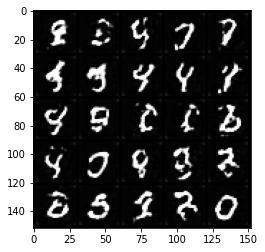

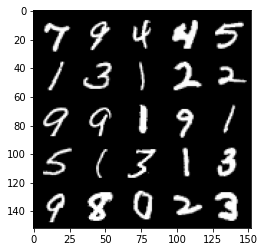

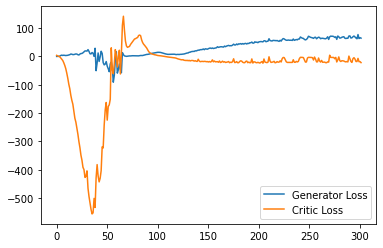

Step 6100: Generator loss: 67.65447547912598, critic loss: -14.959621736049654


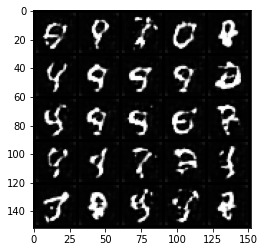

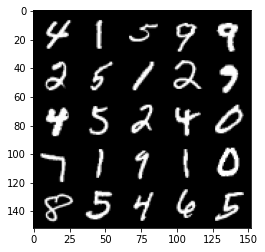

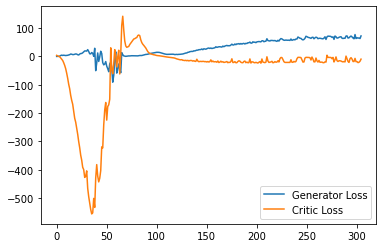

Step 6150: Generator loss: 64.80047882080078, critic loss: -17.68445982456207


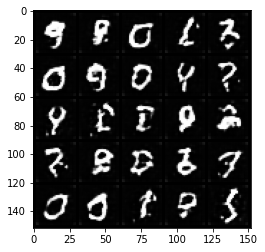

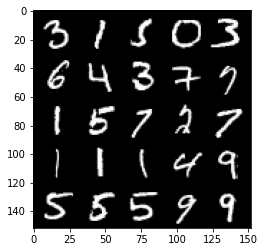

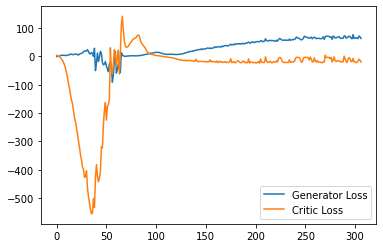

Step 6200: Generator loss: 70.91851280212403, critic loss: -14.73812770175934


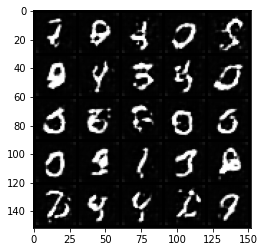

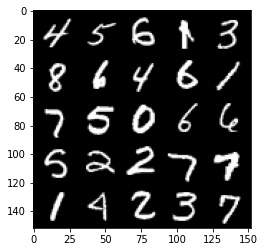

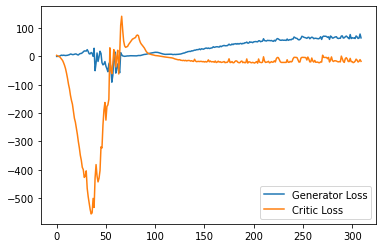

Step 6250: Generator loss: 69.27944747924805, critic loss: -12.034649691104887


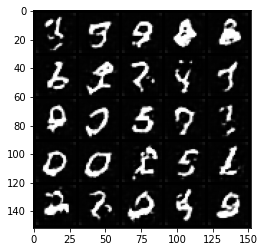

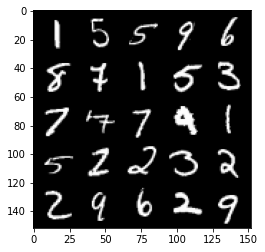

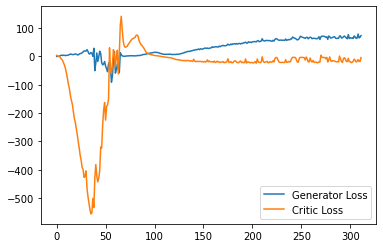

Step 6300: Generator loss: 67.43587242126465, critic loss: -16.31200561618805


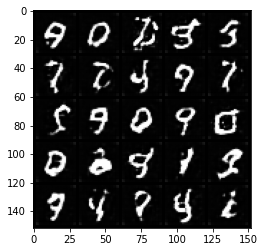

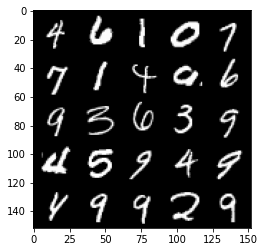

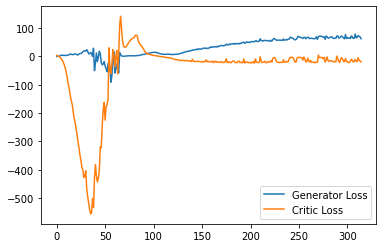

Step 6350: Generator loss: 66.07205421447753, critic loss: -19.06836581850052


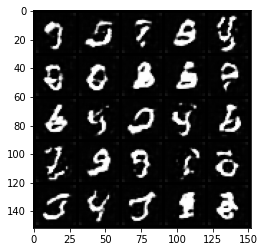

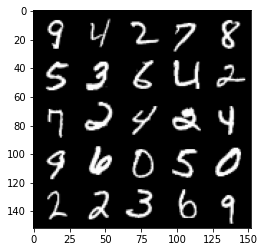

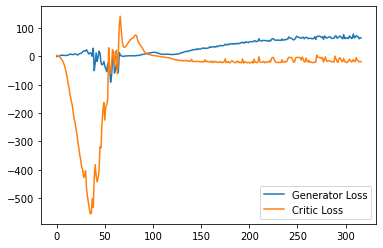

Step 6400: Generator loss: 71.53618721008301, critic loss: -7.101528450489046


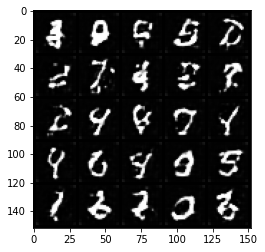

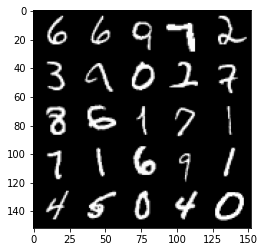

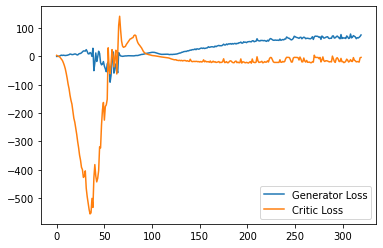

Step 6450: Generator loss: 71.82555877685547, critic loss: -6.561302426338195


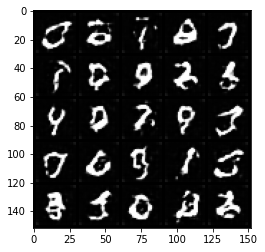

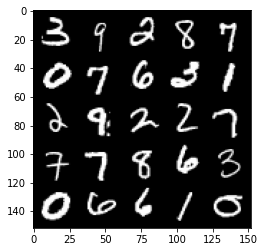

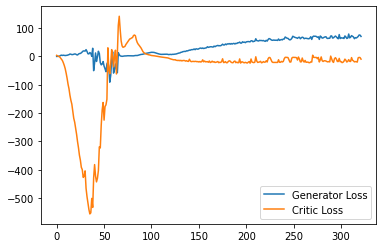

Step 6500: Generator loss: 69.58669998168945, critic loss: -14.609319893836973


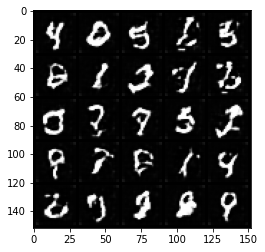

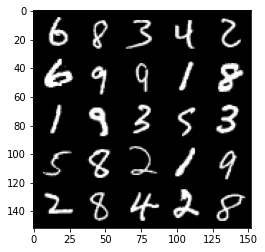

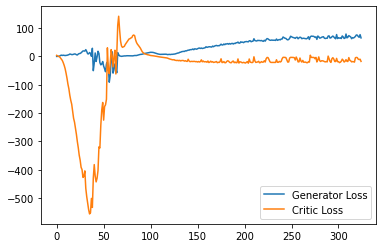

Step 6550: Generator loss: 70.76409729003906, critic loss: -16.01368231248855


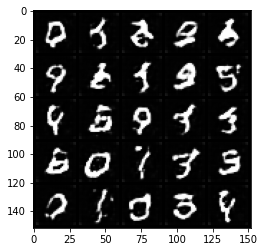

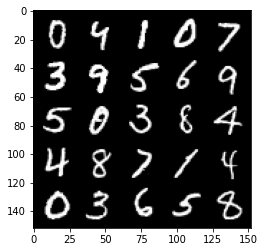

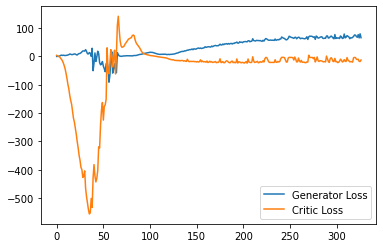

Step 6600: Generator loss: 63.70312683105469, critic loss: -18.375812758922578


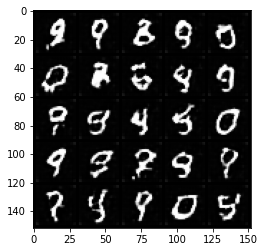

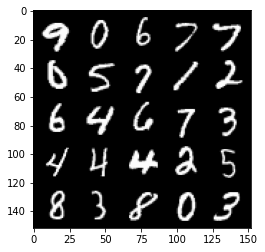

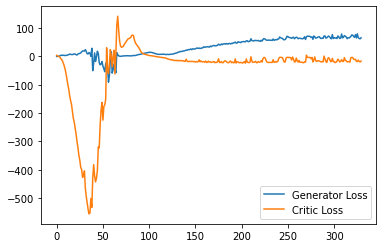

Step 6650: Generator loss: 71.84819152832031, critic loss: -11.812434516906738


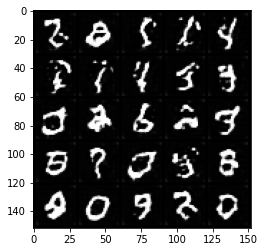

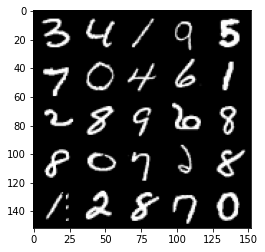

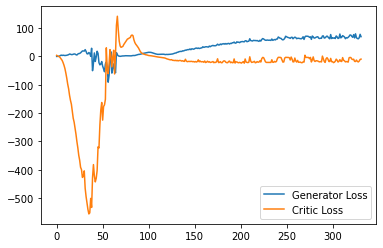

Step 6700: Generator loss: 68.92128868103028, critic loss: -13.87673281288147


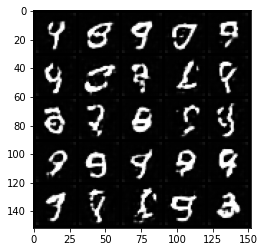

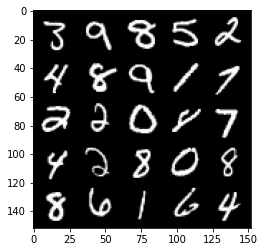

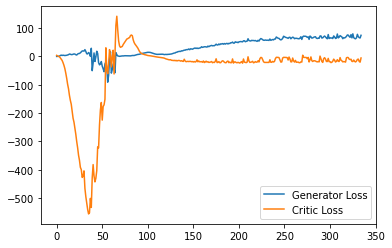

Step 6750: Generator loss: 72.98467346191406, critic loss: -15.854610551357274


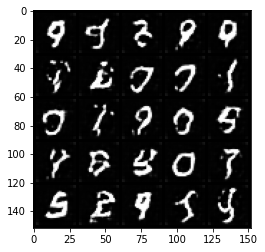

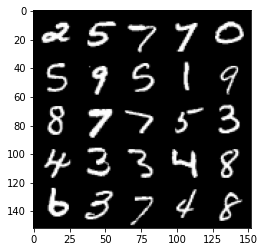

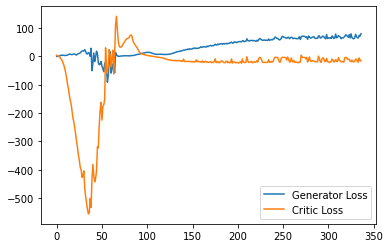

Step 6800: Generator loss: 67.77548461914063, critic loss: -13.760584401607511


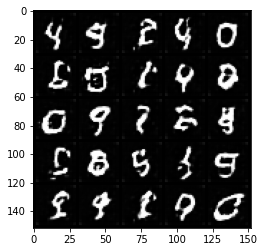

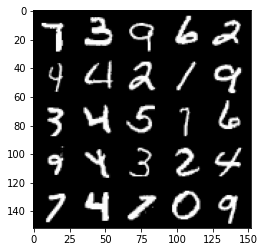

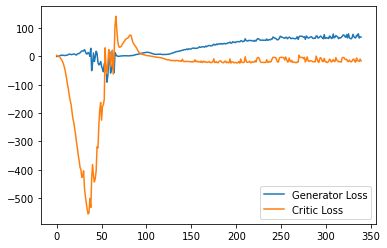

Step 6850: Generator loss: 74.67427795410157, critic loss: -16.09279503774643


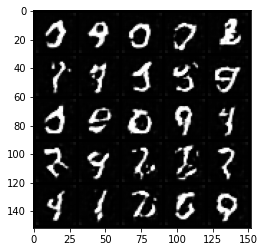

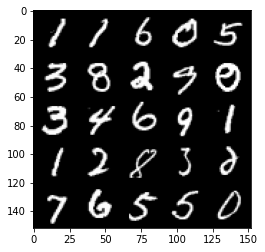

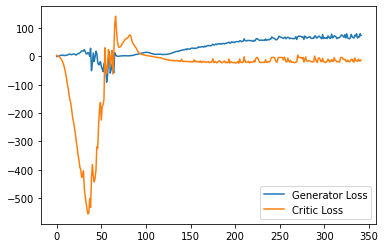

Step 6900: Generator loss: 70.23312690734863, critic loss: -19.832882891178134


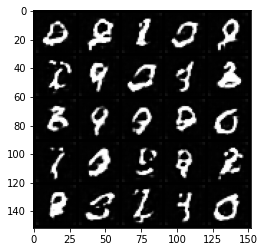

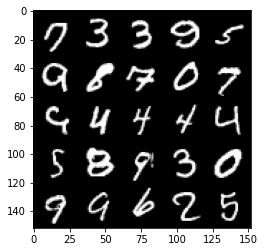

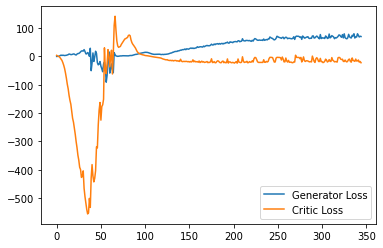

Step 6950: Generator loss: 72.10412063598633, critic loss: -17.622953378200528


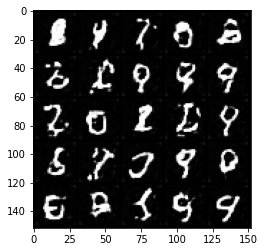

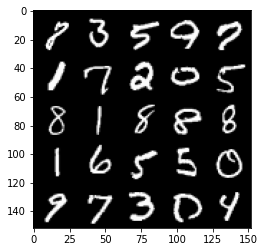

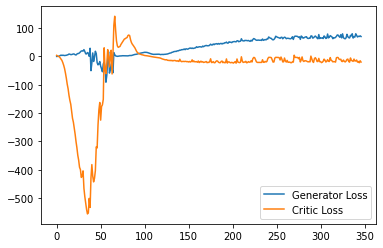

Step 7000: Generator loss: 75.92886558532715, critic loss: -3.0974356164932253


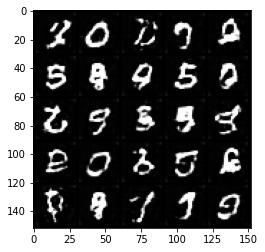

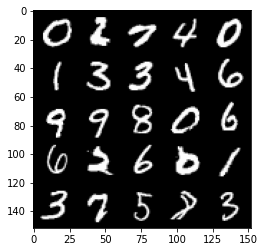

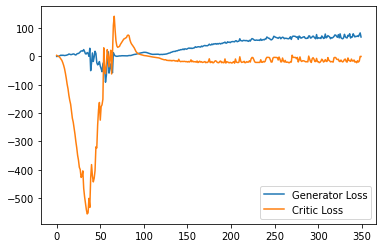

Step 7050: Generator loss: 76.73760108947754, critic loss: -11.641513943195338


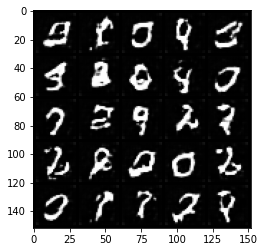

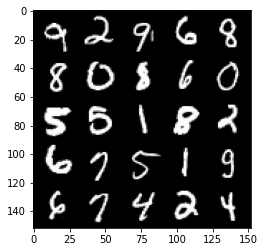

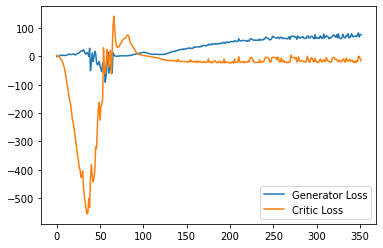

Step 7100: Generator loss: 72.55949897766114, critic loss: -20.311185316085815


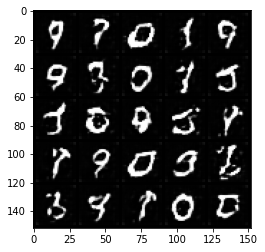

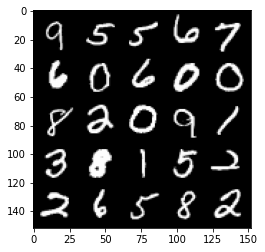

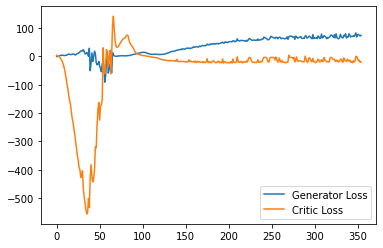

Step 7150: Generator loss: 78.38455169677735, critic loss: -10.999583075046539


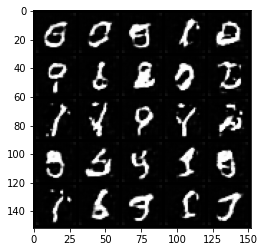

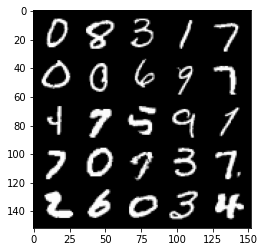

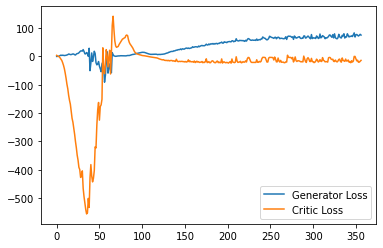

Step 7200: Generator loss: 77.44283157348633, critic loss: -13.119300887107851


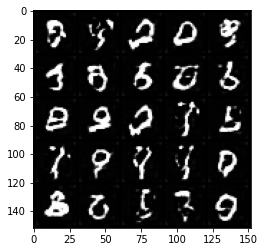

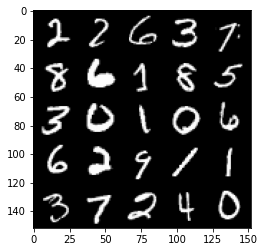

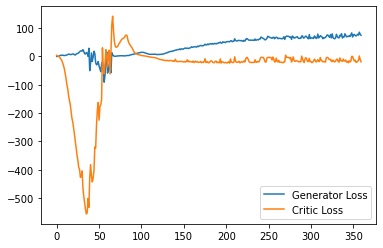

Step 7250: Generator loss: 82.3120637512207, critic loss: -16.854484146118168


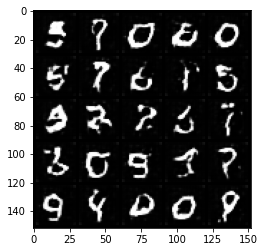

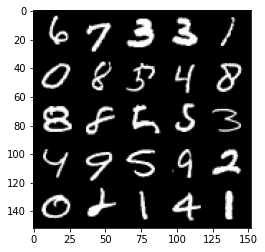

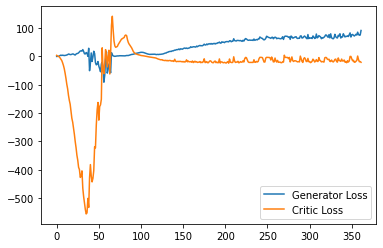

Step 7300: Generator loss: 74.88322860717773, critic loss: -14.814829459667205


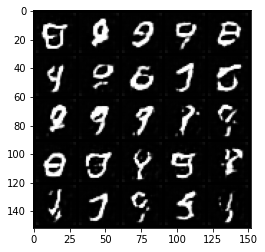

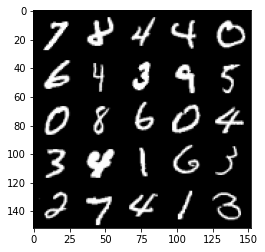

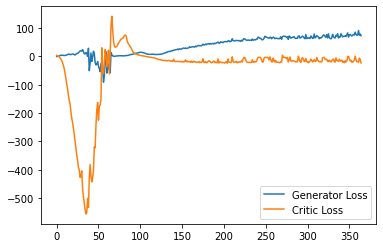

Step 7350: Generator loss: 81.26364974975586, critic loss: -4.0892729780674


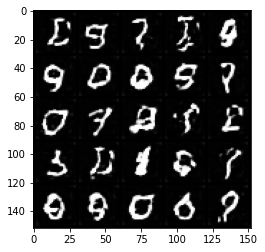

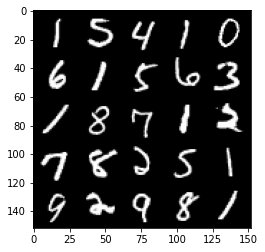

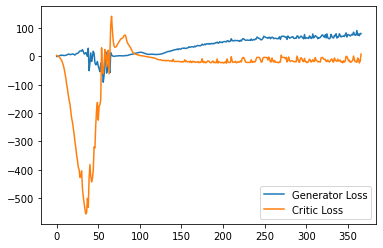

Step 7400: Generator loss: 83.57514678955079, critic loss: -3.1489524526596067


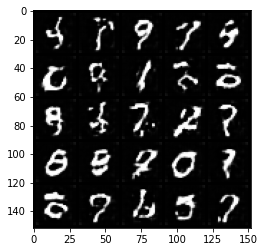

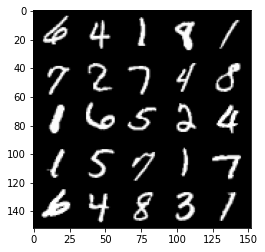

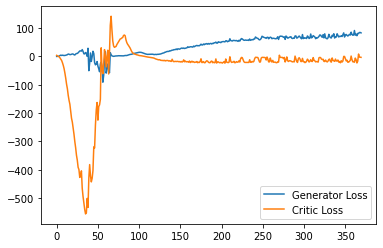

Step 7450: Generator loss: 80.12427505493164, critic loss: -8.168076548576353


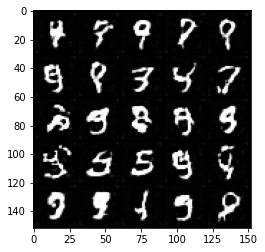

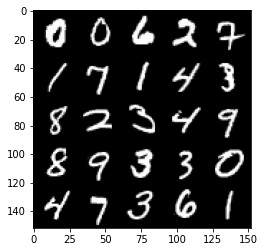

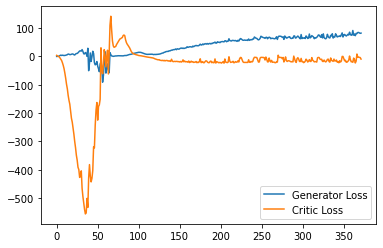

Step 7500: Generator loss: 78.22099380493164, critic loss: -14.579803771018982


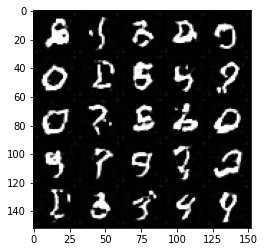

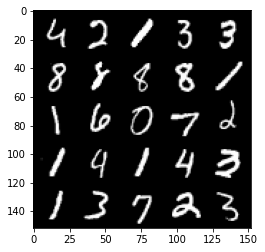

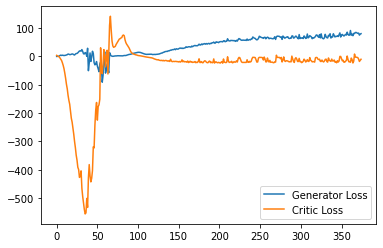

Step 7550: Generator loss: 80.80722183227539, critic loss: -12.78774645423889


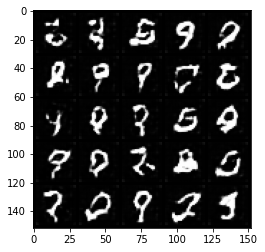

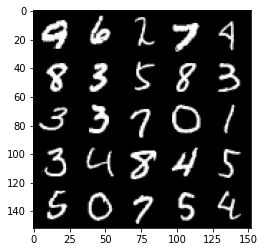

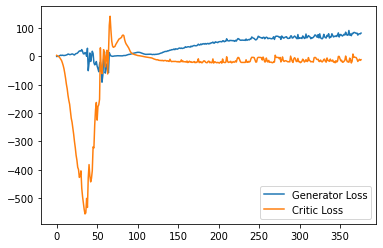

Step 7600: Generator loss: 80.15362686157226, critic loss: -14.175226760387417


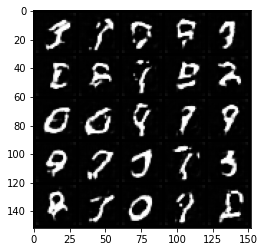

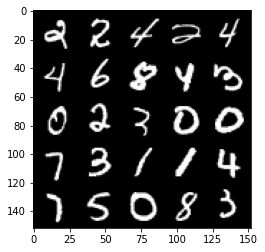

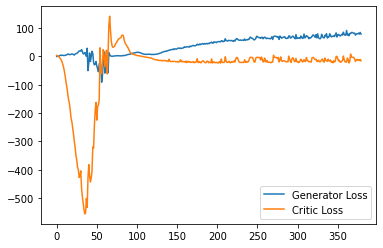

Step 7650: Generator loss: 76.16288909912109, critic loss: -20.42261799502373


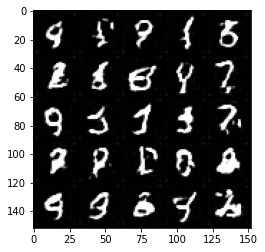

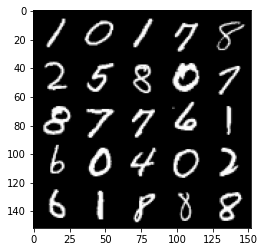

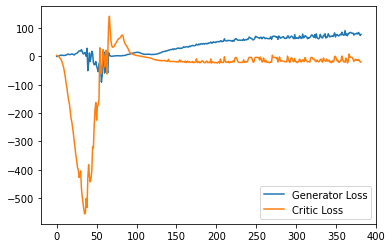

Step 7700: Generator loss: 78.13341194152832, critic loss: -16.30348720598221


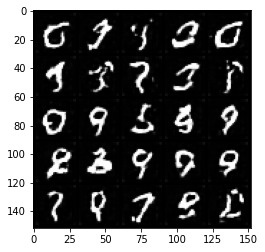

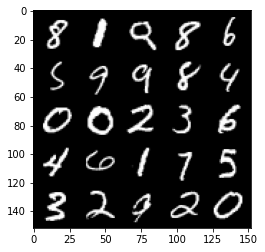

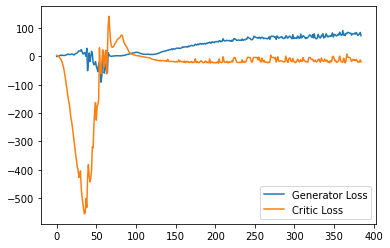

Step 7750: Generator loss: 79.70160614013672, critic loss: -19.125589177608493


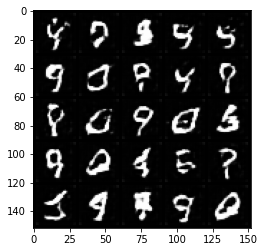

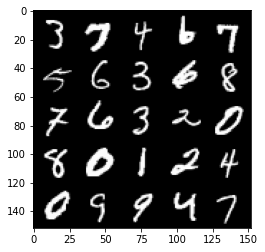

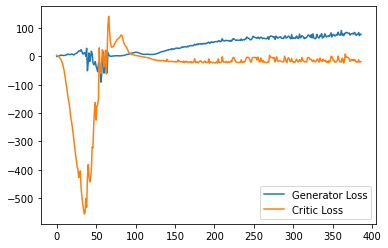

In [ ]:
import matplotlib.pyplot as plt

cur_step = 0
generator_losses = []
critic_losses = []
for epoch in range(n_epochs):
    # Dataloader returns the batches
    for real, _ in tqdm(dataloader):
        cur_batch_size = len(real)
        real = real.to(device)

        mean_iteration_critic_loss = 0
        for _ in range(crit_repeats):
            ### Update critic ###
            crit_opt.zero_grad()
            fake_noise = get_noise(cur_batch_size, z_dim, device=device)
            fake = gen(fake_noise)
            crit_fake_pred = crit(fake.detach())
            crit_real_pred = crit(real)

            epsilon = torch.rand(len(real), 1, 1, 1, device=device, requires_grad=True)
            gradient = get_gradient(crit, real, fake.detach(), epsilon)
            gp = gradient_penalty(gradient)
            crit_loss = get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda)

            # Keep track of the average critic loss in this batch
            mean_iteration_critic_loss += crit_loss.item() / crit_repeats
            # Update gradients
            crit_loss.backward(retain_graph=True)
            # Update optimizer
            crit_opt.step()
        critic_losses += [mean_iteration_critic_loss]

        ### Update generator ###
        gen_opt.zero_grad()
        fake_noise_2 = get_noise(cur_batch_size, z_dim, device=device)
        fake_2 = gen(fake_noise_2)
        crit_fake_pred = crit(fake_2)
        
        gen_loss = get_gen_loss(crit_fake_pred)
        gen_loss.backward()

        # Update the weights
        gen_opt.step()

        # Keep track of the average generator loss
        generator_losses += [gen_loss.item()]

        ### Visualization code ###
        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            crit_mean = sum(critic_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, critic loss: {crit_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(critic_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Critic Loss"
            )
            plt.legend()
            plt.show()

        cur_step += 1
